# **Imports**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
from IPython.display import clear_output
!pip install tf_explain
clear_output()

In [3]:
# common
import os
import keras
import numpy as np
import pandas as pd
from glob import glob
import tensorflow as tf
import tensorflow.image as tfi

# Data
from keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical

# Data Viz
import matplotlib.pyplot as plt

# Model
from keras.models import Model
from keras.layers import Layer
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import UpSampling2D
from keras.layers import concatenate
from keras.layers import Add
from keras.layers import Multiply
from keras.layers import Input
from keras.layers import MaxPool2D
from keras.layers import BatchNormalization

# Callbacks
from keras.callbacks import Callback
from keras.callbacks import EarlyStopping
from keras.callbacks import ModelCheckpoint
from tf_explain.core.grad_cam import GradCAM

# Metrics
from keras.metrics import MeanIoU

# **Data**

In [4]:
def load_image(image, SIZE):
    return np.round(tfi.resize(img_to_array(load_img(image))/255.,(SIZE, SIZE)),4)

def load_images(image_paths, SIZE, mask=False, trim=None):
    if trim is not None:
        image_paths = image_paths[:trim]

    if mask:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 1))
    else:
        images = np.zeros(shape=(len(image_paths), SIZE, SIZE, 3))

    for i,image in enumerate(image_paths):
        img = load_image(image,SIZE)
        if mask:
            images[i] = img[:,:,:1]
        else:
            images[i] = img

    return images

In [5]:
def show_image(image, title=None, cmap=None, alpha=1):
    plt.imshow(image, cmap=cmap, alpha=alpha)
    if title is not None:
        plt.title(title)
    plt.axis('off')

def show_mask(image, mask, cmap=None, alpha=0.4):
    plt.imshow(image)
    plt.imshow(tf.squeeze(mask), cmap=cmap, alpha=alpha)
    plt.axis('off')

In [6]:
SIZE = 256

In [7]:
root_path = '/content/drive/Othercomputers/Mi PC/Master IA/Practicas Empresa/Imagen/taza_dataset_angle/modelo-tr/Datos/'
classes = sorted(os.listdir(root_path))
classes

['objetos', 'taza']

In [8]:
single_mask_paths = sorted([sorted(glob(root_path + name + "/*mask.png")) for name in classes])
double_mask_paths = sorted([sorted(glob(root_path + name + "/*mask_1.png")) for name in classes])
triple_mask_paths = sorted([sorted(glob(root_path + name + "/*mask_2.png")) for name in classes])

In [9]:
angles_df = pd.read_csv('/content/drive/Othercomputers/Mi PC/Master IA/Practicas Empresa/Imagen/taza_dataset_angle/modelo-tr/Angulo_figuras_normalizado.csv', delimiter = ';')
angles_df.head()

,image_name,angle_magnitude_norm
0,figura5_frame_0.png,"0,089042"
1,figura5_frame_1.png,"0,107978"
2,figura5_frame_2.png,"0,090033"
3,figura5_frame_3.png,"0,076063"
4,figura5_frame_4.png,"0,05902"


In [10]:
angles_dict = dict(zip(angles_df['image_name'], angles_df['angle_magnitude_norm']))

In [11]:
image_paths = []
mask_paths = []

for class_path in single_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask','')
        image_paths.append(img_path)
        mask_paths.append(path)

In [12]:
for class_path in double_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask1','')
        image_paths.append(img_path)
        mask_paths.append(path)

In [13]:
for class_path in triple_mask_paths:
    for path in class_path:
        img_path = path.replace('_mask2','')
        image_paths.append(img_path)
        mask_paths.append(path)

In [14]:
angles = np.zeros(shape=(len(image_paths), 1))  # Un array de Nx1 donde N es el número de imágenes

# Llenar el array con los valores del diccionario de ángulos
for i, img_path in enumerate(image_paths):
    angles[i] = float(angles_dict[os.path.basename(img_path)].replace(",","."))

In [15]:
angles[2]

array([-0.242116])

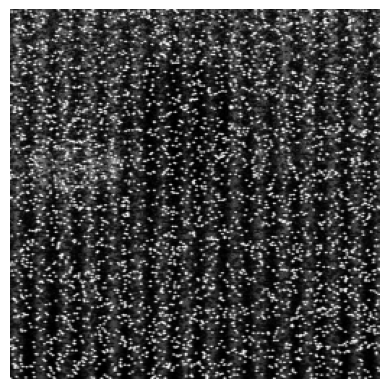

In [16]:
show_image(load_image(image_paths[0], SIZE))

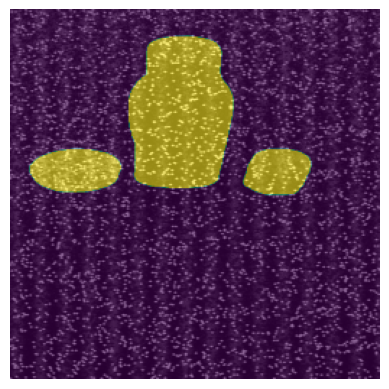

In [17]:
show_mask(load_image(image_paths[0], SIZE), load_image(mask_paths[0], SIZE)[:,:,0], alpha=0.6)

## **Data Work**

In [18]:
images = load_images(image_paths, SIZE)
masks = load_images(mask_paths, SIZE, mask=True)

In [19]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='jet')
plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

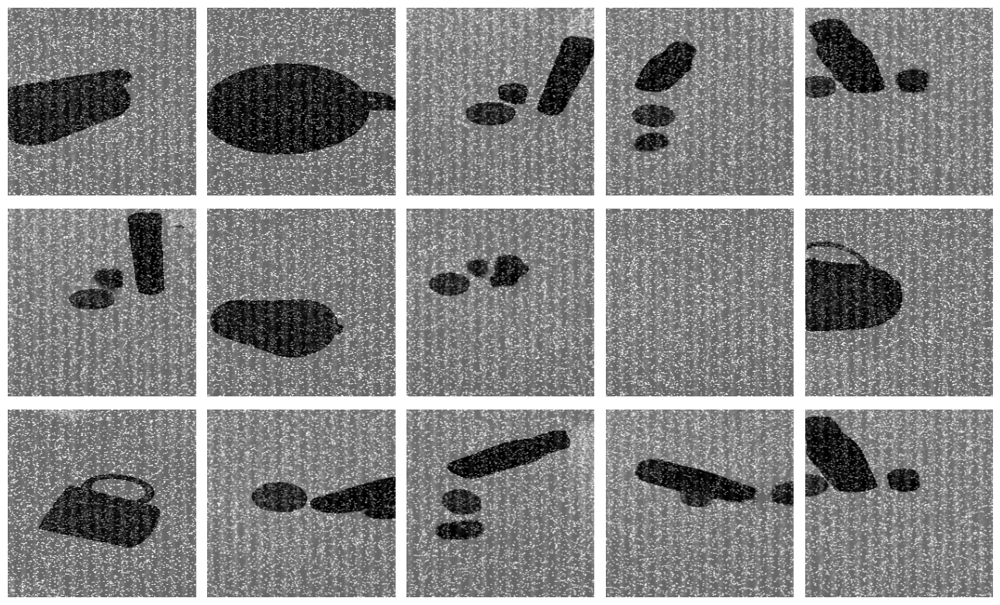

In [20]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='binary')
plt.tight_layout()
plt.show()

In [21]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='afmhot')
plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [22]:
plt.figure(figsize=(13,8))
for i in range(15):
    plt.subplot(3,5,i+1)
    id = np.random.randint(len(images))
    show_mask(images[id], masks[id], cmap='copper')
plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

# **Encoder**

In [23]:
class EncoderBlock(Layer):

    def __init__(self, filters, rate, pooling=True, **kwargs):
        super(EncoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate
        self.pooling = pooling

        self.c1 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.drop = Dropout(rate)
        self.c2 = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', kernel_initializer='he_normal')
        self.pool = MaxPool2D()

    def call(self, X):
        x = self.c1(X)
        x = self.drop(x)
        x = self.c2(x)
        if self.pooling:
            y = self.pool(x)
            return y, x
        else:
            return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
            'pooling':self.pooling
        }

# **Decoder**

In [24]:
class DecoderBlock(Layer):

    def __init__(self, filters, rate, **kwargs):
        super(DecoderBlock, self).__init__(**kwargs)

        self.filters = filters
        self.rate = rate

        self.up = UpSampling2D()
        self.net = EncoderBlock(filters, rate, pooling=False)

    def call(self, X):
        X, skip_X = X
        x = self.up(X)
        c_ = concatenate([x, skip_X])
        x = self.net(c_)
        return x

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            'rate':self.rate,
        }

# **Attention Gate**

In [25]:
class AttentionGate(Layer):

    def __init__(self, filters, bn, **kwargs):
        super(AttentionGate, self).__init__(**kwargs)

        self.filters = filters
        self.bn = bn

        self.normal = Conv2D(filters, kernel_size=3, padding='same', activation='relu', kernel_initializer='he_normal')
        self.down = Conv2D(filters, kernel_size=3, strides=2, padding='same', activation='relu', kernel_initializer='he_normal')
        self.learn = Conv2D(1, kernel_size=1, padding='same', activation='sigmoid')
        self.resample = UpSampling2D()
        self.BN = BatchNormalization()

    def call(self, X):
        X, skip_X = X

        x = self.normal(X)
        skip = self.down(skip_X)
        x = Add()([x, skip])
        x = self.learn(x)
        x = self.resample(x)
        f = Multiply()([x, skip_X])
        if self.bn:
            return self.BN(f)
        else:
            return f
        # return f

    def get_config(self):
        base_config = super().get_config()
        return {
            **base_config,
            "filters":self.filters,
            "bn":self.bn
        }

# **Custom Callback**

In [26]:
import matplotlib.pyplot as plt
import numpy as np
from keras.callbacks import Callback

class ShowProgress(Callback):
    def __init__(self, images, masks, angles):
        super(ShowProgress, self).__init__()
        # Almacenamos las imágenes y las máscaras para mostrar durante el entrenamiento
        self.images = images
        self.masks = masks
        self.angles = angles

    def on_epoch_end(self, epoch, logs=None):
        # Seleccionamos un índice aleatorio para visualizar
        index = np.random.randint(0, len(self.images))

        # Obtenemos la imagen original, la máscara objetivo y el ángulo correspondiente
        original_image = self.images[index]
        target_mask = self.masks[index]
        angle_input = self.angles[index]  # Obtener el ángulo correspondiente

        # Predecir usando el modelo (incluyendo el ángulo)
        predicted_mask = self.model.predict(
            [np.expand_dims(original_image, axis=0), np.expand_dims(angle_input, axis=0)]
        )[0]

        # Visualizamos las tres imágenes: original, objetivo y predicción
        fig, ax = plt.subplots(1, 3, figsize=(12, 4))

        # Imagen original
        ax[0].imshow(original_image.squeeze(), cmap='gray')
        ax[0].set_title('Imagen Original')
        ax[0].axis('off')

        # Máscara objetivo
        ax[1].imshow(target_mask.squeeze(), cmap='gray')
        ax[1].set_title('Máscara Objetivo')
        ax[1].axis('off')

        # Máscara predicha
        ax[2].imshow(predicted_mask.squeeze(), cmap='gray')
        ax[2].set_title('Máscara Predicción')
        ax[2].axis('off')

        # Mostramos las imágenes
        plt.show()


# **Angle managment**

In [27]:
import tensorflow as tf
from tensorflow.keras import layers
class AngleProcessingLayer(layers.Layer):
    def __init__(self, output_size, **kwargs):
        super(AngleProcessingLayer, self).__init__(**kwargs)
        self.output_size = output_size

    def call(self, angle_input):
        # Cambiar la forma a (batch_size, 1)
        angle_expanded = tf.expand_dims(angle_input, axis=1)  # Cambiar la forma a (batch_size, 1)
        angle_expanded = tf.expand_dims(angle_expanded, axis=2)  # Cambiar la forma a (batch_size, 1, 1)
        # Redimensionamos el ángulo para que coincida con la salida del encoder
        angle_processed = tf.tile(angle_expanded, [1, self.output_size[0], self.output_size[1], 1])  # Repetir para que coincida
        return angle_processed



# **Attention UNet**

In [30]:
from keras.layers import Concatenate
# Inputs
input_layer = Input(shape=images.shape[-3:])
angle_input = Input(shape=(1,))
# Encoder
p1, c1 = EncoderBlock(32,0.1, name="Encoder1")(input_layer)
p2, c2 = EncoderBlock(64,0.1, name="Encoder2")(p1)
p3, c3 = EncoderBlock(128,0.2, name="Encoder3")(p2)
p4, c4 = EncoderBlock(256,0.2, name="Encoder4")(p3)

# Encoding
encoding = EncoderBlock(512,0.3, pooling=False, name="Encoding")(p4)

# Procesar el ángulo
angle_processing_layer = AngleProcessingLayer(output_size=(encoding.shape[1], encoding.shape[2]))
angle_processed = angle_processing_layer(angle_input)

# Concatenar el ángulo con la salida del codificador
combined_encoding = Concatenate(axis=-1)([encoding, angle_processed])


# Attention + Decoder

a1 = AttentionGate(256, bn=True, name="Attention1")([combined_encoding, c4])
d1 = DecoderBlock(256,0.2, name="Decoder1")([combined_encoding, a1])

a2 = AttentionGate(128, bn=True, name="Attention2")([d1, c3])
d2 = DecoderBlock(128,0.2, name="Decoder2")([d1, a2])

a3 = AttentionGate(64, bn=True, name="Attention3")([d2, c2])
d3 = DecoderBlock(64,0.1, name="Decoder3")([d2, a3])



a4 = AttentionGate(32, bn=True, name="Attention4")([d3, c1])
d4 = DecoderBlock(32,0.1, name="Decoder4")([d3, a4])

# Output
output_layer = Conv2D(1, kernel_size=1, activation='sigmoid', padding='same')(d4)

# Model
model = Model(
    inputs=[input_layer, angle_input],
    outputs=[output_layer]
)

# Compile
model.compile(
    loss='binary_crossentropy',
    optimizer='adam',
    metrics=['accuracy', MeanIoU(num_classes=2, name='IoU')]
)

# Callbacks
cb = [
    ModelCheckpoint("/content/drive/Othercomputers/Mi PC/Master IA/Practicas Empresa/Imagen/taza_dataset_angle/modelo-tr/Modelos_entrenados/unet-angulo-encode.keras", save_best_only=True),
    ShowProgress(images=images, masks=masks, angles=angles),
    EarlyStopping(
        monitor='val_loss',  # Observa la pérdida de validación
        patience=100,         # Número de épocas sin mejora antes de detener el entrenamiento
        restore_best_weights=True  # Restaura los mejores pesos obtenidos
    )
]



# **Training**

Epoch 1/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


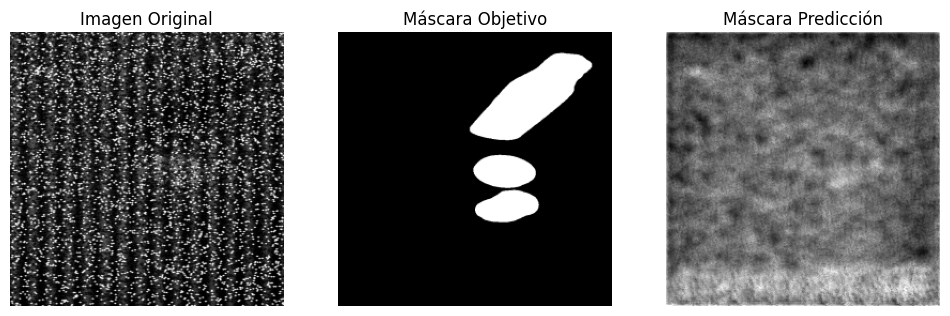

74/74 ━━━━━━━━━━━━━━━━━━━━ 98s 951ms/step - IoU: 0.4648 - accuracy: 0.8236 - loss: 0.6609 - val_IoU: 0.4636 - val_accuracy: 0.9254 - val_loss: 0.5477
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


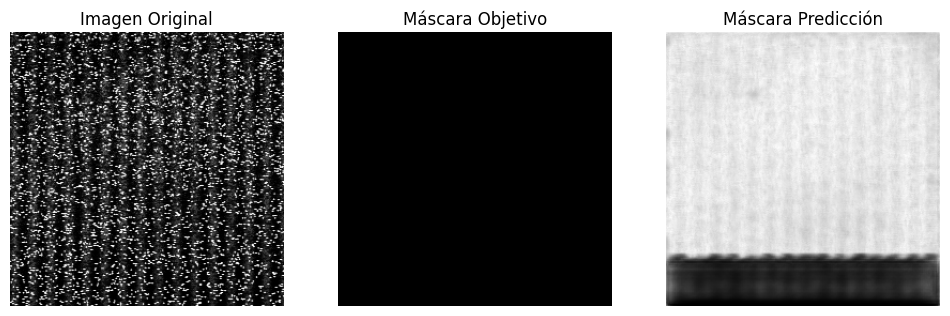

74/74 ━━━━━━━━━━━━━━━━━━━━ 74s 246ms/step - IoU: 0.4656 - accuracy: 0.8738 - loss: 0.2926 - val_IoU: 0.4636 - val_accuracy: 0.9254 - val_loss: 0.4614
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


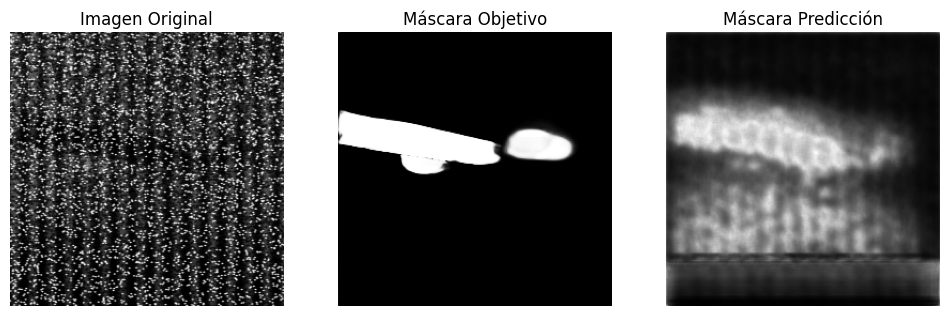

74/74 ━━━━━━━━━━━━━━━━━━━━ 18s 243ms/step - IoU: 0.4657 - accuracy: 0.8789 - loss: 0.2657 - val_IoU: 0.4636 - val_accuracy: 0.9344 - val_loss: 0.4213
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


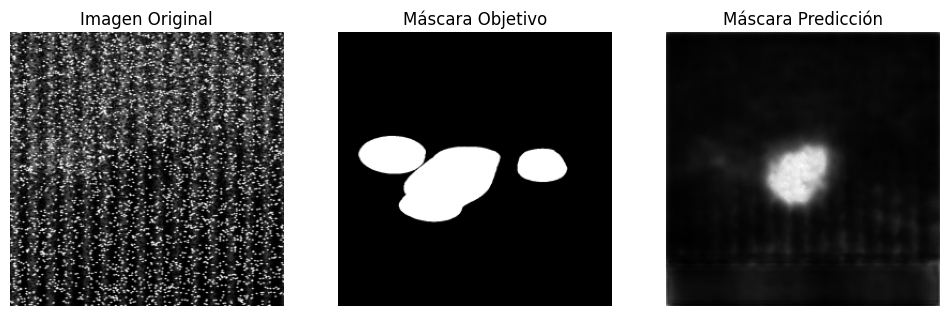

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 238ms/step - IoU: 0.4675 - accuracy: 0.8794 - loss: 0.2145 - val_IoU: 0.4636 - val_accuracy: 0.9249 - val_loss: 0.1830
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


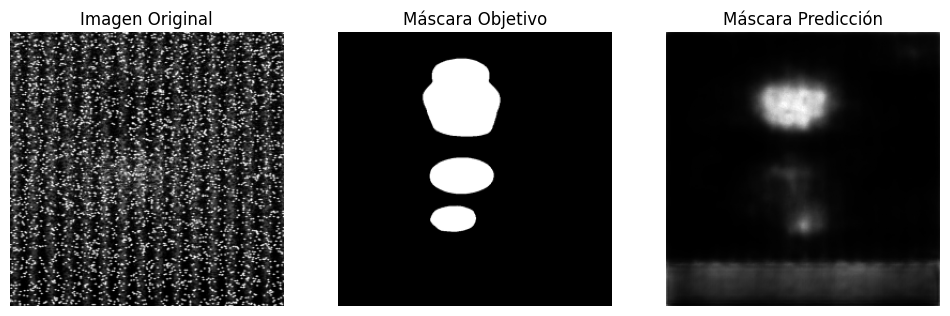

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 238ms/step - IoU: 0.4673 - accuracy: 0.8925 - loss: 0.1554 - val_IoU: 0.4636 - val_accuracy: 0.9486 - val_loss: 0.1372
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


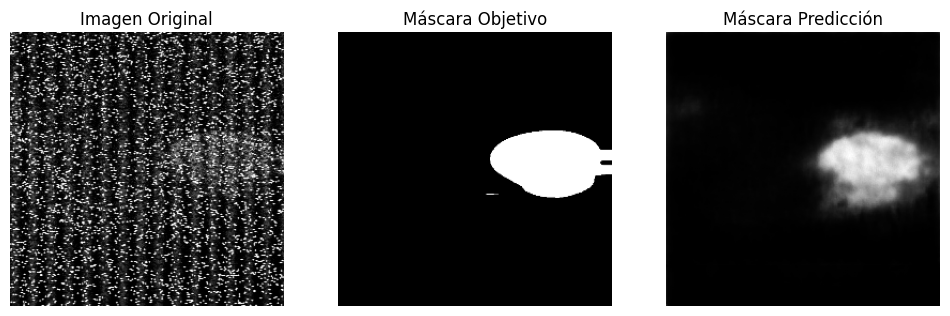

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 246ms/step - IoU: 0.4657 - accuracy: 0.9008 - loss: 0.1255 - val_IoU: 0.4636 - val_accuracy: 0.9567 - val_loss: 0.1005
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


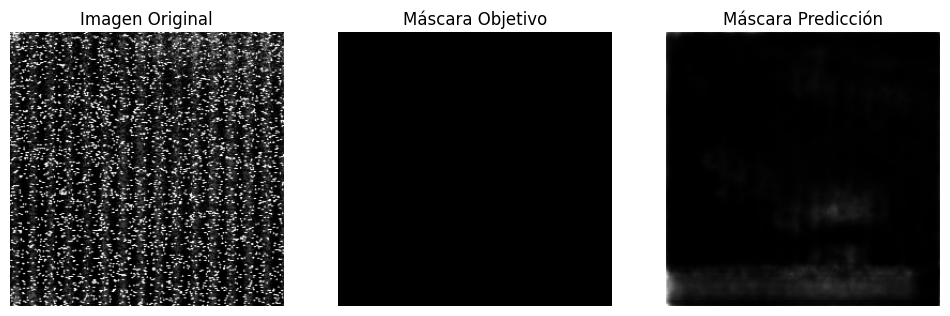

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 242ms/step - IoU: 0.4660 - accuracy: 0.9052 - loss: 0.1136 - val_IoU: 0.4636 - val_accuracy: 0.9615 - val_loss: 0.0930
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


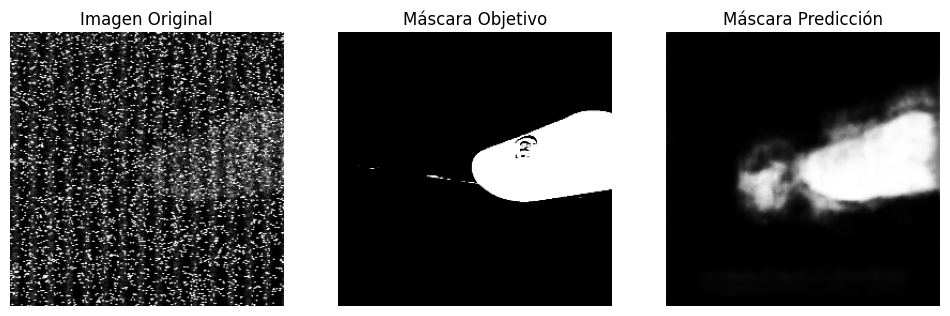

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 240ms/step - IoU: 0.4677 - accuracy: 0.9033 - loss: 0.1092 - val_IoU: 0.4636 - val_accuracy: 0.9625 - val_loss: 0.0859
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


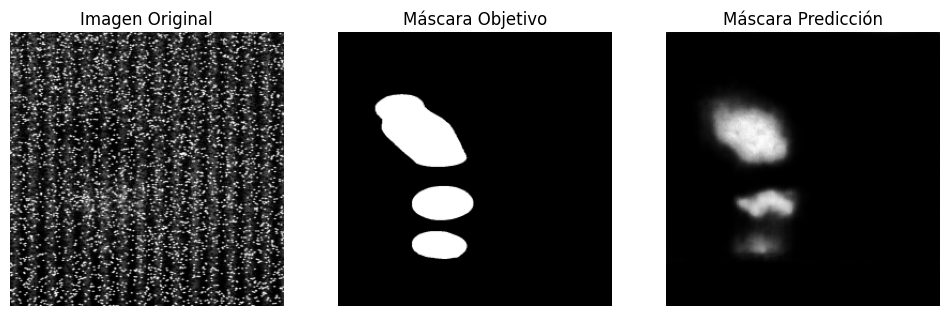

74/74 ━━━━━━━━━━━━━━━━━━━━ 19s 225ms/step - IoU: 0.4657 - accuracy: 0.9100 - loss: 0.0848 - val_IoU: 0.4636 - val_accuracy: 0.9610 - val_loss: 0.0985
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


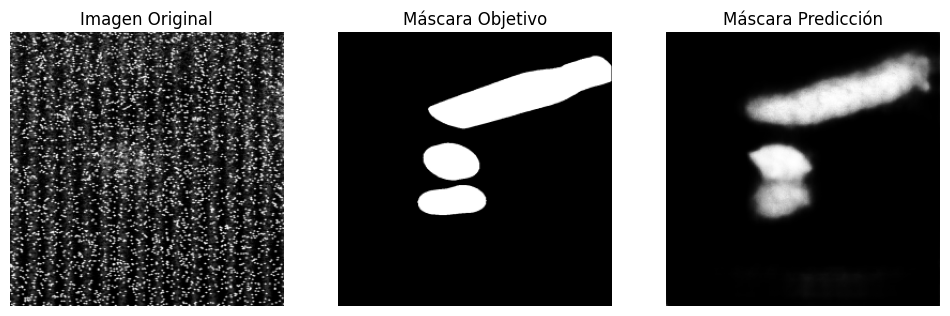

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 237ms/step - IoU: 0.4635 - accuracy: 0.9105 - loss: 0.0919 - val_IoU: 0.4636 - val_accuracy: 0.9688 - val_loss: 0.0778
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


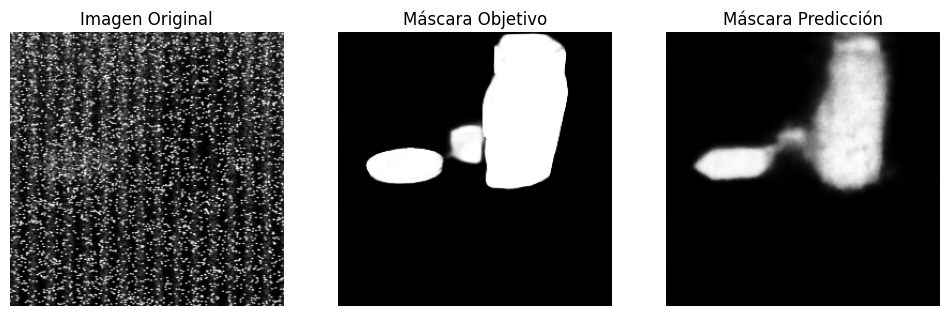

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 231ms/step - IoU: 0.4662 - accuracy: 0.9133 - loss: 0.0713 - val_IoU: 0.4636 - val_accuracy: 0.9506 - val_loss: 0.1186
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


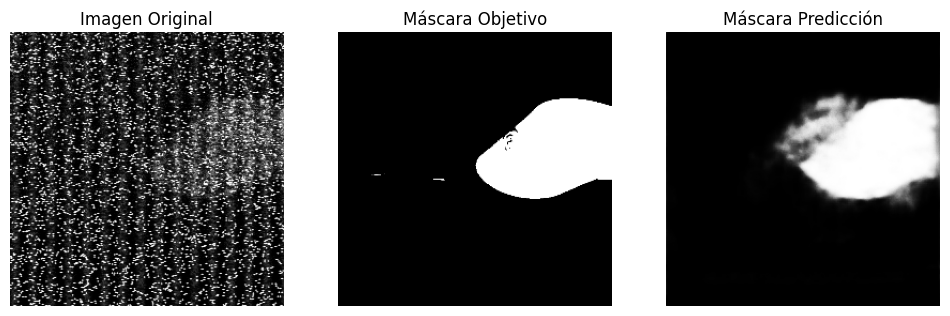

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 228ms/step - IoU: 0.4684 - accuracy: 0.9109 - loss: 0.0752 - val_IoU: 0.4636 - val_accuracy: 0.9701 - val_loss: 0.0798
Epoch 13/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


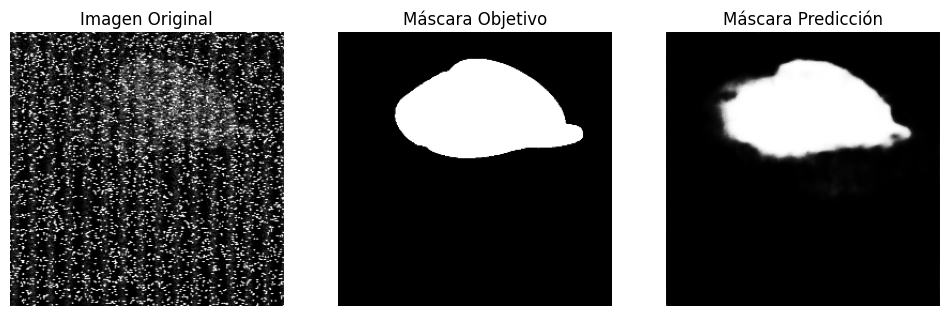

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 231ms/step - IoU: 0.4662 - accuracy: 0.9149 - loss: 0.0676 - val_IoU: 0.4636 - val_accuracy: 0.9571 - val_loss: 0.1170
Epoch 14/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


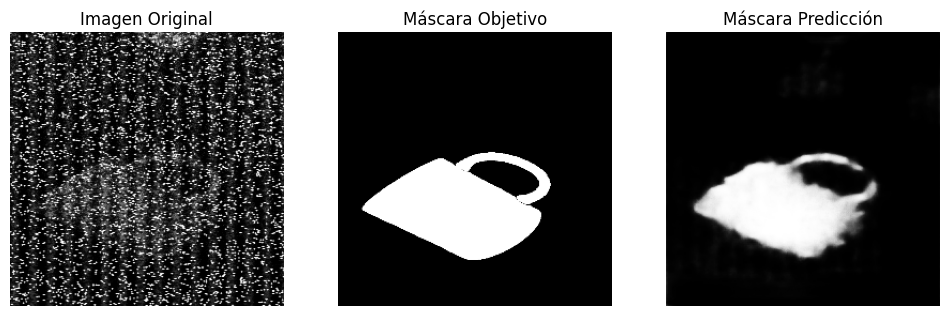

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 237ms/step - IoU: 0.4670 - accuracy: 0.9106 - loss: 0.0694 - val_IoU: 0.4636 - val_accuracy: 0.9701 - val_loss: 0.0751
Epoch 15/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


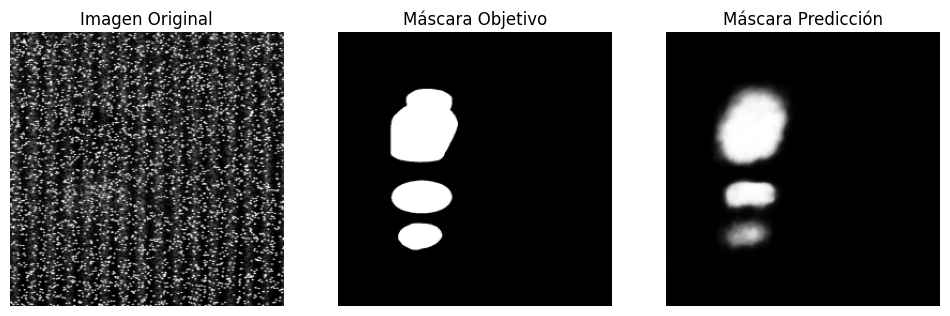

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 237ms/step - IoU: 0.4679 - accuracy: 0.9149 - loss: 0.0660 - val_IoU: 0.4636 - val_accuracy: 0.9743 - val_loss: 0.0739
Epoch 16/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


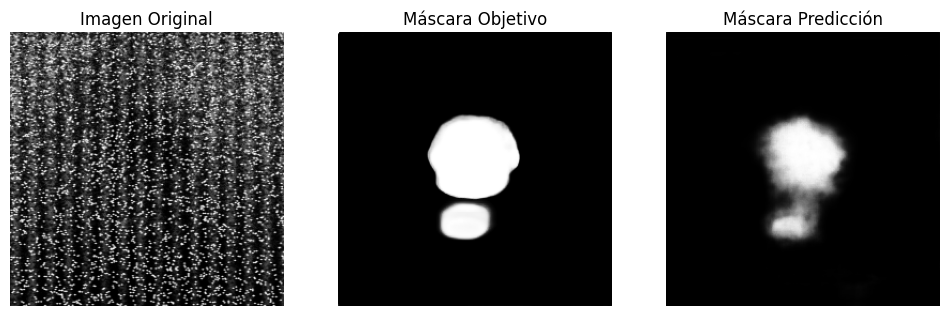

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.4673 - accuracy: 0.9209 - loss: 0.0535 - val_IoU: 0.4636 - val_accuracy: 0.9691 - val_loss: 0.0793
Epoch 17/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


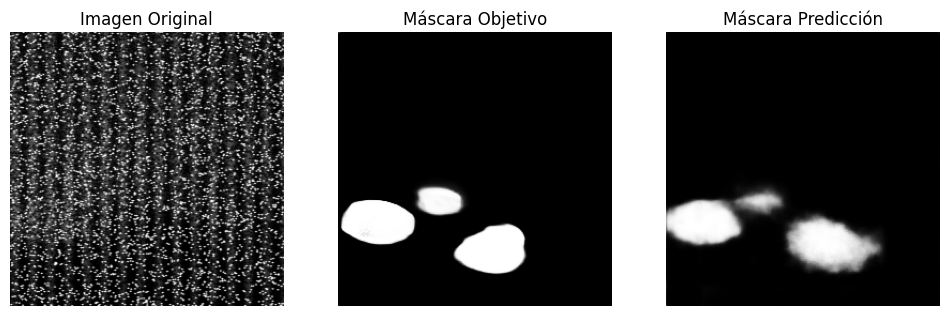

74/74 ━━━━━━━━━━━━━━━━━━━━ 22s 240ms/step - IoU: 0.4664 - accuracy: 0.9182 - loss: 0.0639 - val_IoU: 0.4636 - val_accuracy: 0.9750 - val_loss: 0.0662
Epoch 18/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


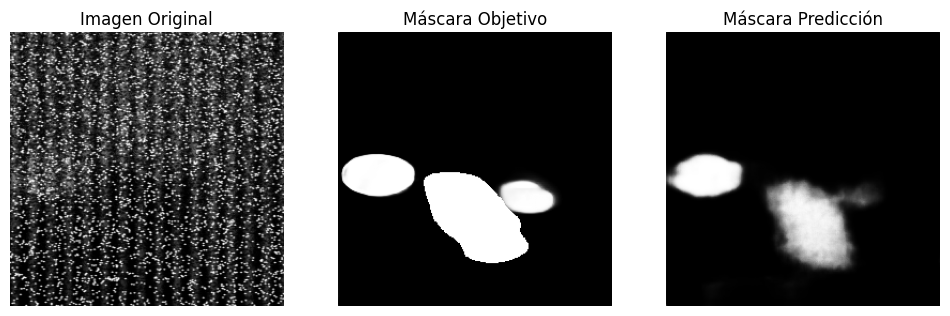

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 231ms/step - IoU: 0.4648 - accuracy: 0.9211 - loss: 0.0508 - val_IoU: 0.4636 - val_accuracy: 0.9701 - val_loss: 0.0920
Epoch 19/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


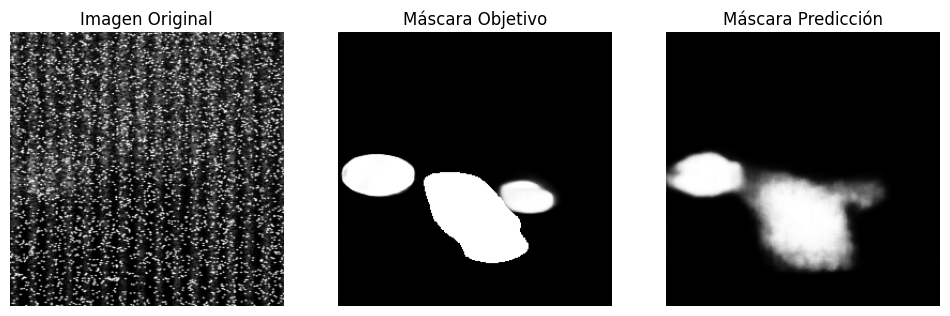

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.4683 - accuracy: 0.9185 - loss: 0.0504 - val_IoU: 0.4637 - val_accuracy: 0.9592 - val_loss: 0.1160
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


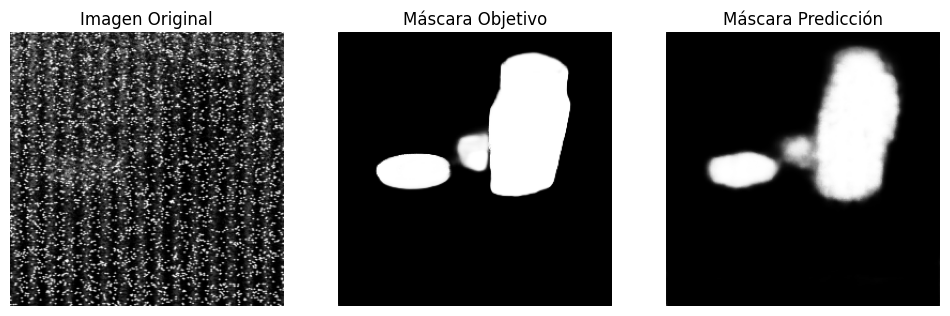

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 233ms/step - IoU: 0.4649 - accuracy: 0.9194 - loss: 0.0593 - val_IoU: 0.4636 - val_accuracy: 0.9639 - val_loss: 0.1022
Epoch 21/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


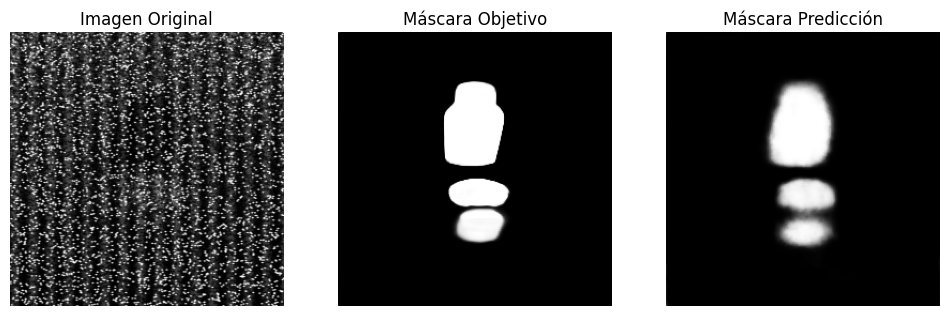

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 225ms/step - IoU: 0.4669 - accuracy: 0.9191 - loss: 0.0478 - val_IoU: 0.4636 - val_accuracy: 0.9657 - val_loss: 0.0995
Epoch 22/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


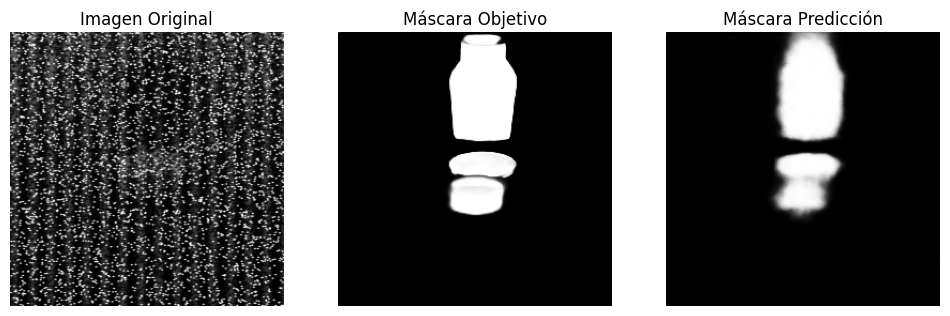

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 228ms/step - IoU: 0.4657 - accuracy: 0.9216 - loss: 0.0467 - val_IoU: 0.4636 - val_accuracy: 0.9621 - val_loss: 0.1037
Epoch 23/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


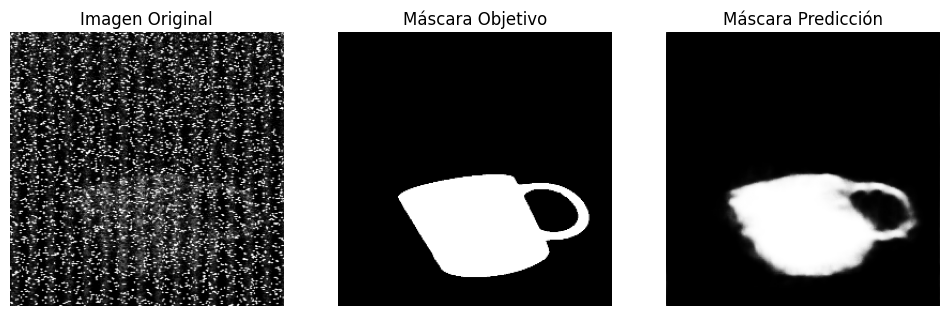

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 230ms/step - IoU: 0.4694 - accuracy: 0.9204 - loss: 0.0454 - val_IoU: 0.4636 - val_accuracy: 0.9712 - val_loss: 0.0823
Epoch 24/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


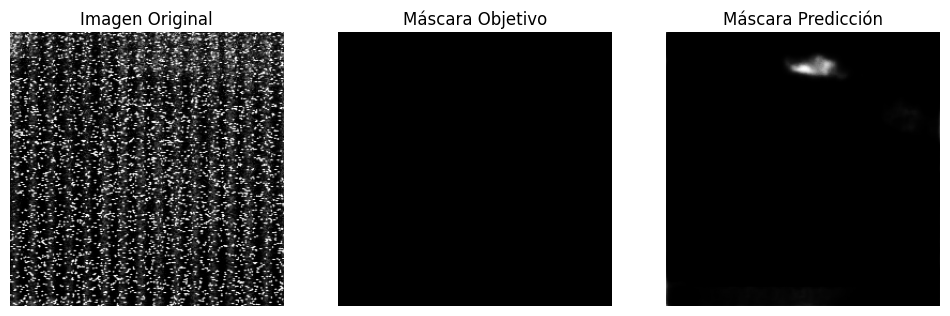

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.4696 - accuracy: 0.9207 - loss: 0.0448 - val_IoU: 0.4636 - val_accuracy: 0.9714 - val_loss: 0.0856
Epoch 25/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


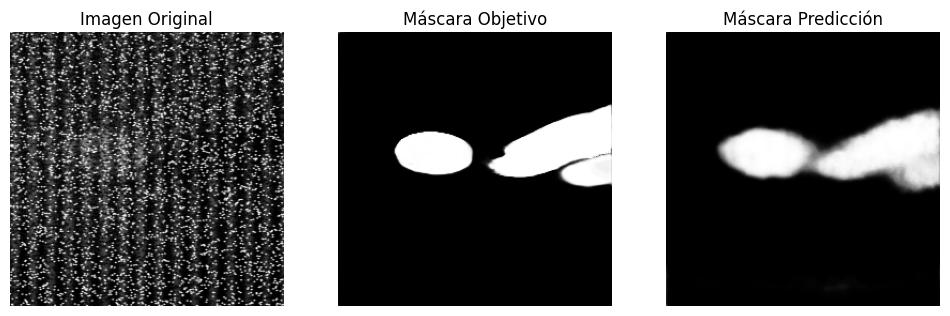

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 229ms/step - IoU: 0.4649 - accuracy: 0.9223 - loss: 0.0428 - val_IoU: 0.4636 - val_accuracy: 0.9737 - val_loss: 0.0684
Epoch 26/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


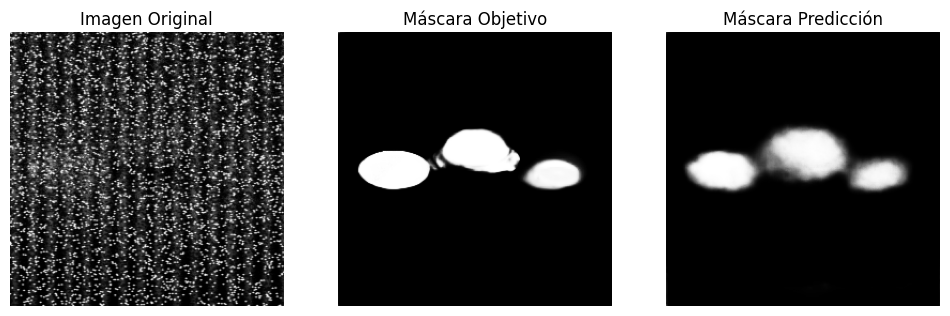

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.4662 - accuracy: 0.9216 - loss: 0.0428 - val_IoU: 0.4636 - val_accuracy: 0.9683 - val_loss: 0.0890
Epoch 27/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


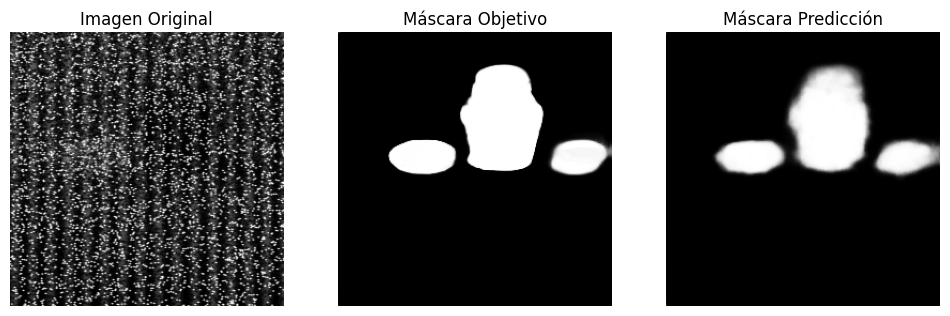

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.4640 - accuracy: 0.9265 - loss: 0.0422 - val_IoU: 0.4636 - val_accuracy: 0.9703 - val_loss: 0.0989
Epoch 28/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


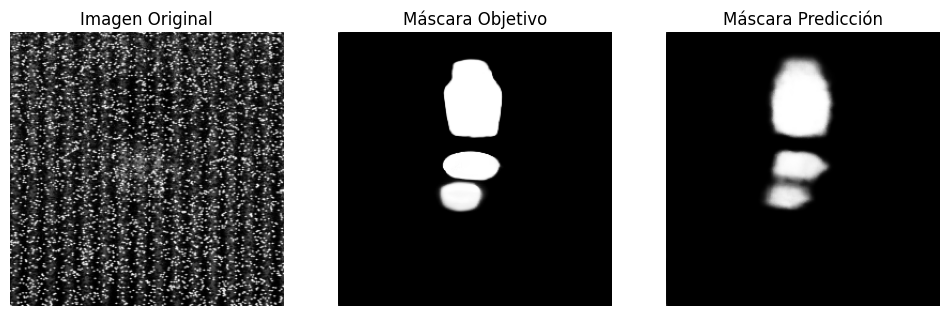

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 230ms/step - IoU: 0.4720 - accuracy: 0.9233 - loss: 0.0365 - val_IoU: 0.4636 - val_accuracy: 0.9644 - val_loss: 0.1107
Epoch 29/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


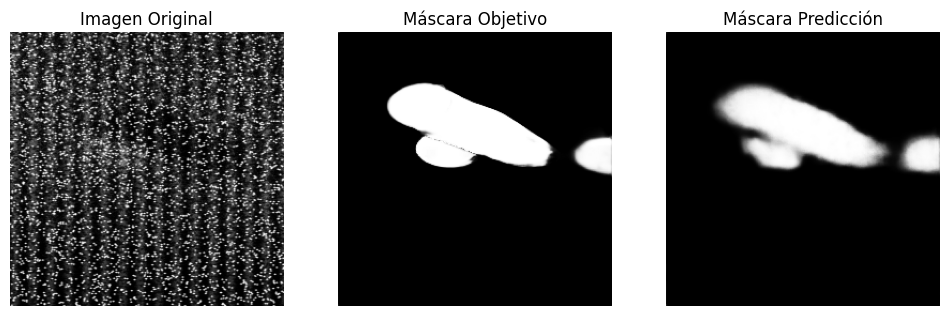

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 224ms/step - IoU: 0.4658 - accuracy: 0.9253 - loss: 0.0391 - val_IoU: 0.4636 - val_accuracy: 0.9749 - val_loss: 0.0909
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


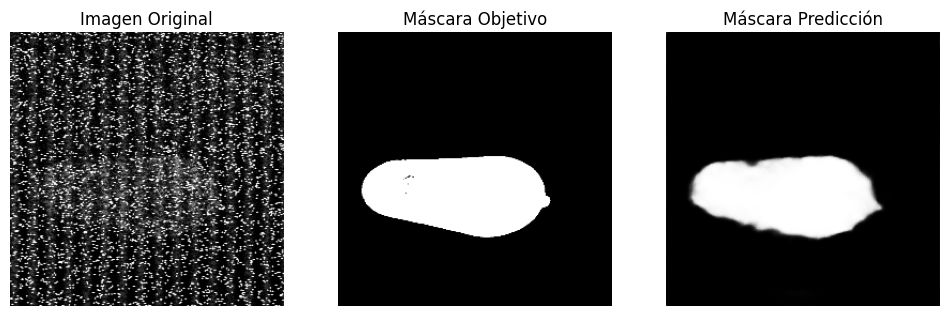

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 224ms/step - IoU: 0.4719 - accuracy: 0.9254 - loss: 0.0380 - val_IoU: 0.4637 - val_accuracy: 0.9697 - val_loss: 0.0958
Epoch 31/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


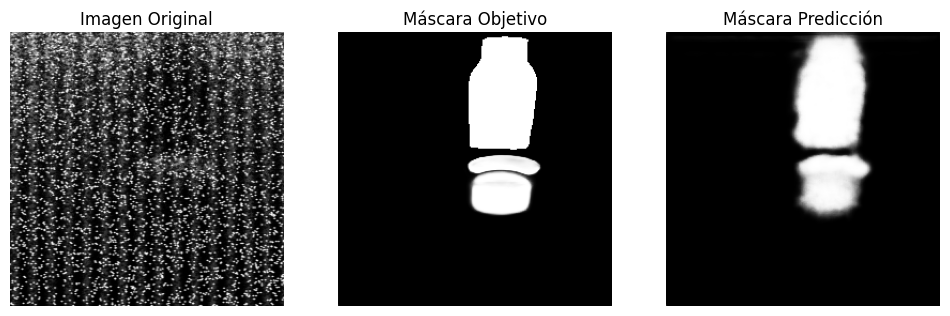

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.4906 - accuracy: 0.9228 - loss: 0.0358 - val_IoU: 0.4636 - val_accuracy: 0.9718 - val_loss: 0.0892
Epoch 32/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


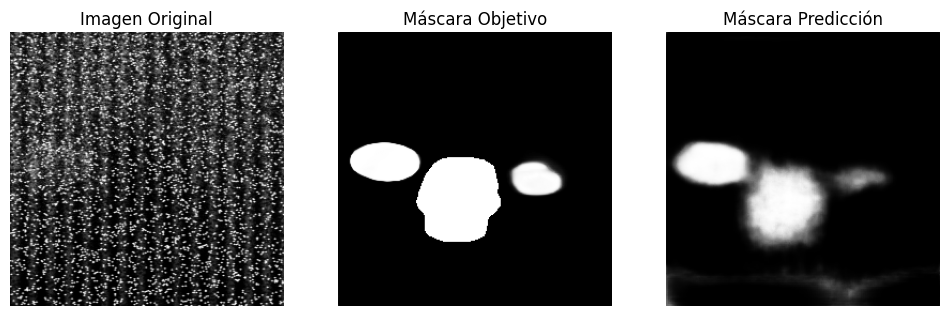

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.4698 - accuracy: 0.9225 - loss: 0.0391 - val_IoU: 0.4636 - val_accuracy: 0.9607 - val_loss: 0.1256
Epoch 33/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


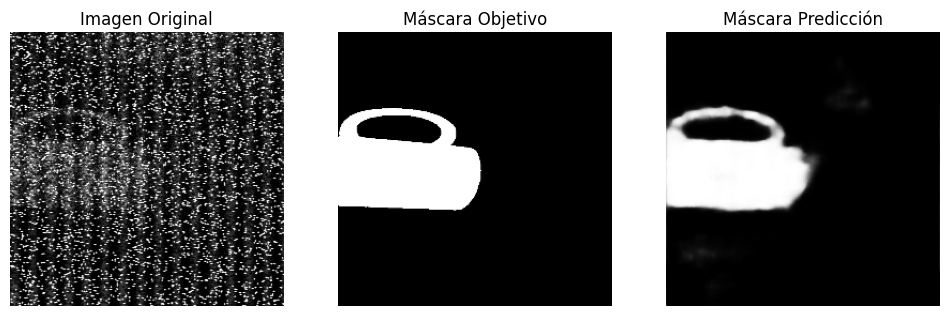

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 229ms/step - IoU: 0.4768 - accuracy: 0.9229 - loss: 0.0449 - val_IoU: 0.4637 - val_accuracy: 0.9713 - val_loss: 0.0895
Epoch 34/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


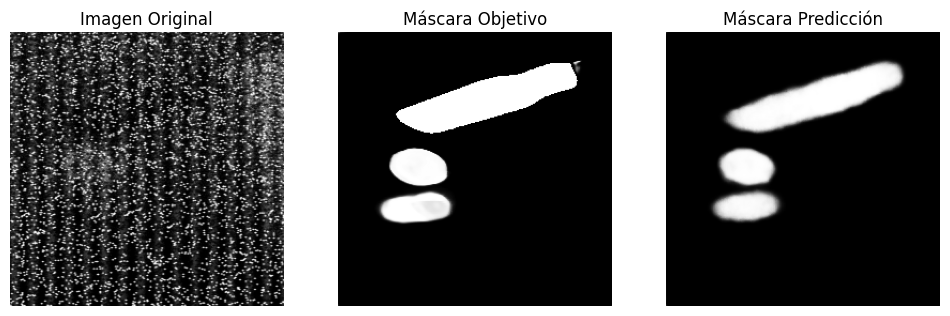

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.4752 - accuracy: 0.9240 - loss: 0.0360 - val_IoU: 0.4636 - val_accuracy: 0.9707 - val_loss: 0.0974
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


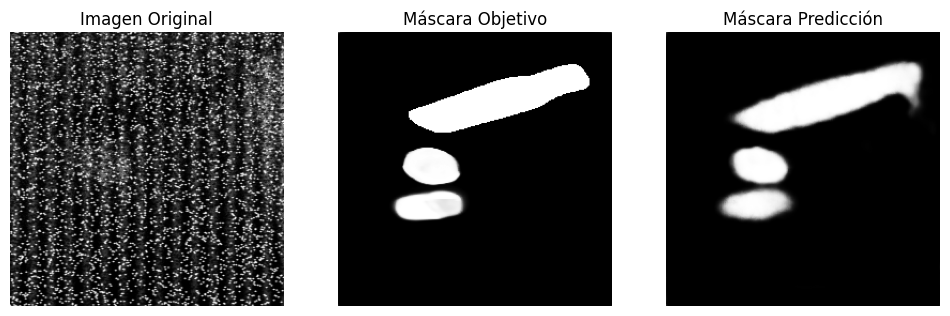

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.4738 - accuracy: 0.9224 - loss: 0.0397 - val_IoU: 0.4636 - val_accuracy: 0.9705 - val_loss: 0.0857
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


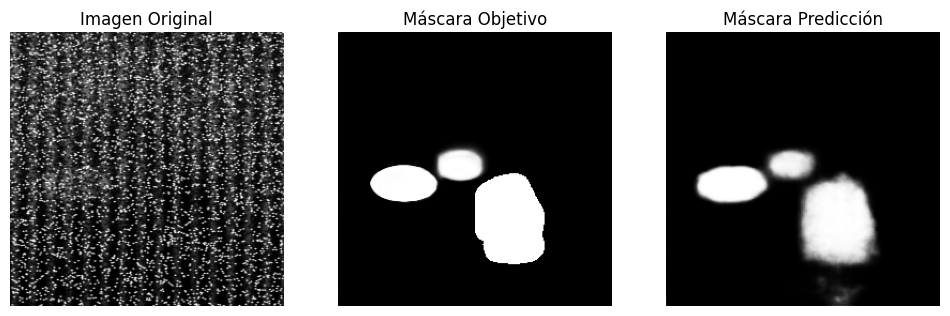

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.4721 - accuracy: 0.9190 - loss: 0.0447 - val_IoU: 0.4637 - val_accuracy: 0.9756 - val_loss: 0.0794
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


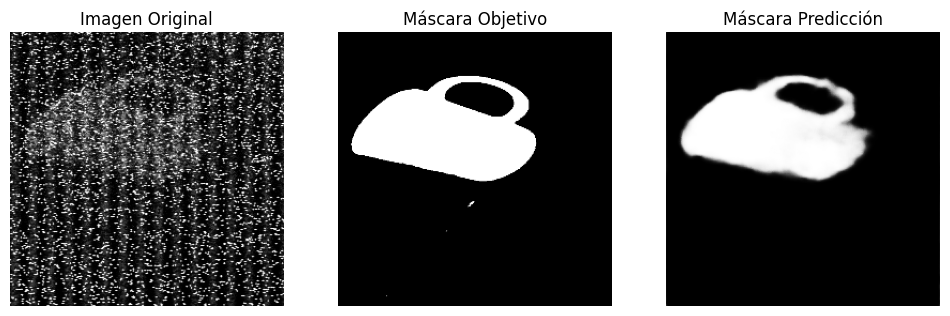

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 228ms/step - IoU: 0.4745 - accuracy: 0.9226 - loss: 0.0449 - val_IoU: 0.4659 - val_accuracy: 0.9719 - val_loss: 0.0995
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


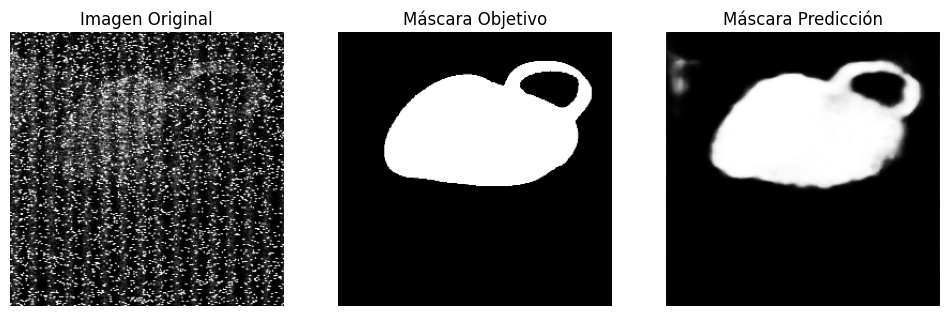

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 228ms/step - IoU: 0.4847 - accuracy: 0.9251 - loss: 0.0337 - val_IoU: 0.4656 - val_accuracy: 0.9717 - val_loss: 0.0916
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


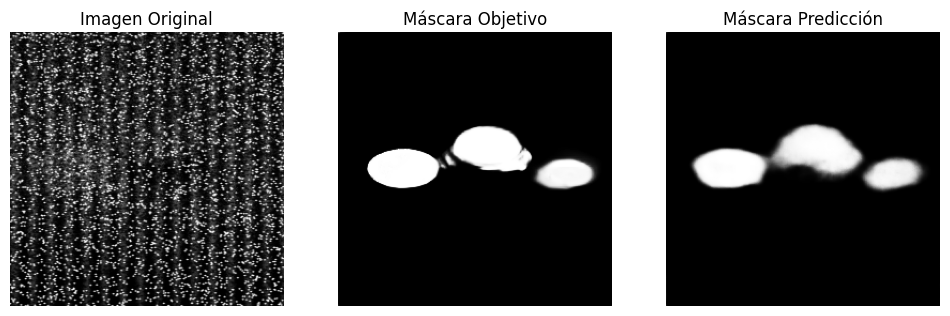

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 229ms/step - IoU: 0.4887 - accuracy: 0.9204 - loss: 0.0340 - val_IoU: 0.4636 - val_accuracy: 0.9753 - val_loss: 0.0798
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


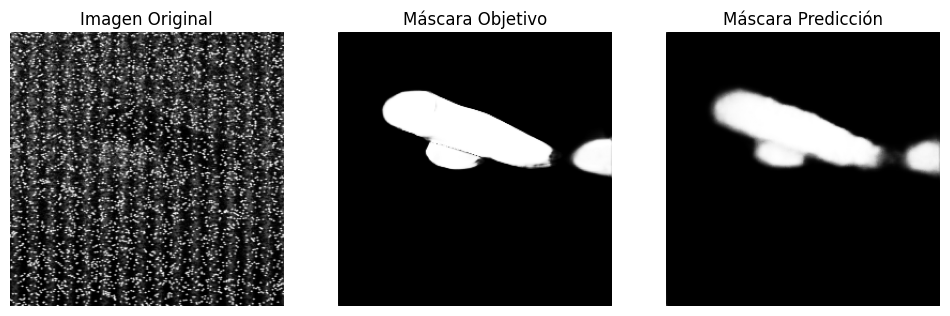

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 230ms/step - IoU: 0.4869 - accuracy: 0.9203 - loss: 0.0336 - val_IoU: 0.4636 - val_accuracy: 0.9702 - val_loss: 0.0871
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


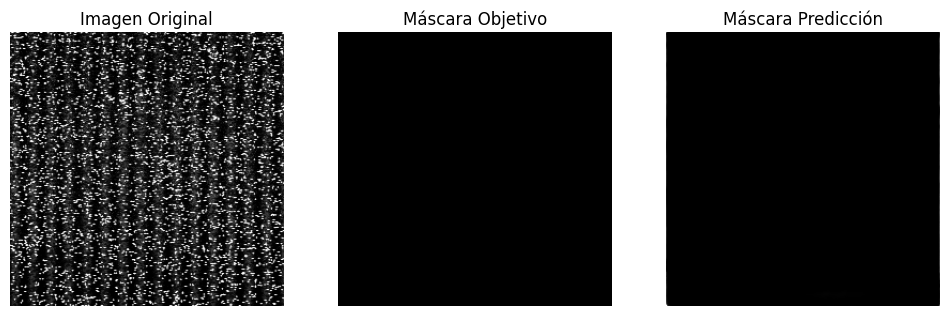

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.4889 - accuracy: 0.9214 - loss: 0.0351 - val_IoU: 0.4657 - val_accuracy: 0.9696 - val_loss: 0.0964
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


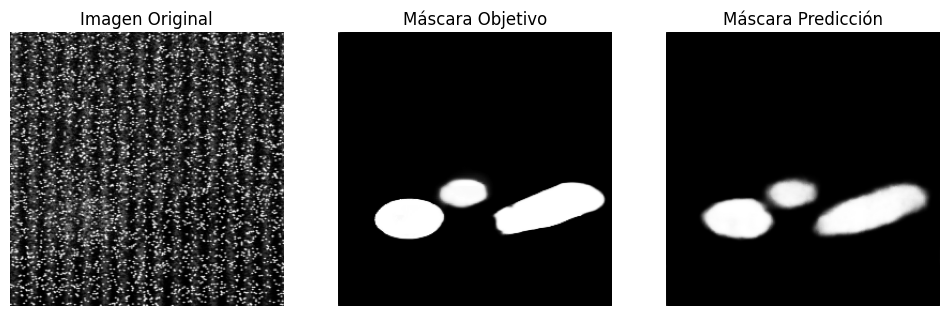

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 224ms/step - IoU: 0.4780 - accuracy: 0.9247 - loss: 0.0318 - val_IoU: 0.4636 - val_accuracy: 0.9721 - val_loss: 0.0947
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


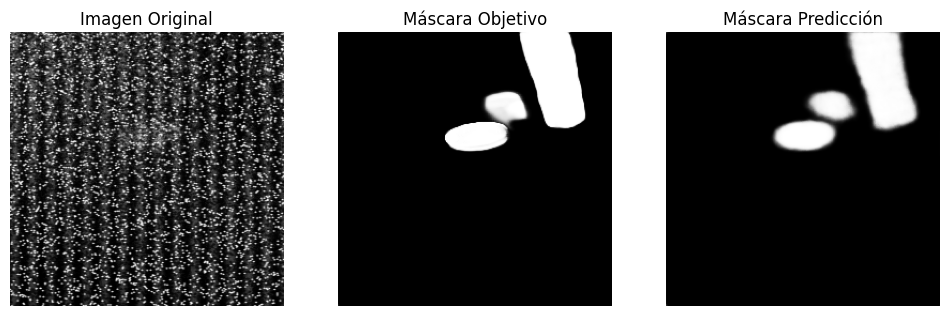

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 232ms/step - IoU: 0.4818 - accuracy: 0.9276 - loss: 0.0317 - val_IoU: 0.4694 - val_accuracy: 0.9723 - val_loss: 0.0975
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


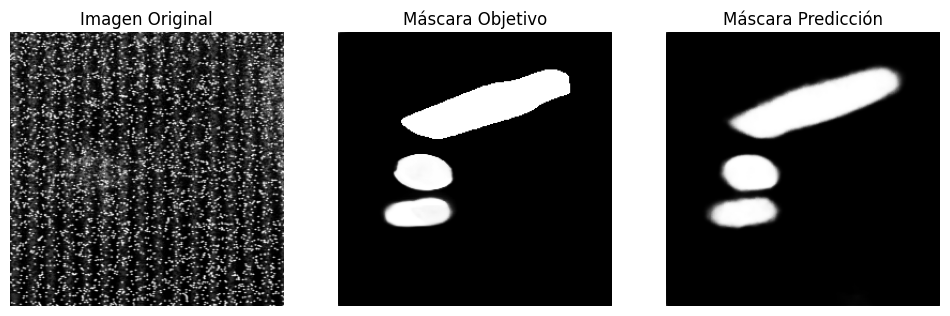

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 223ms/step - IoU: 0.5037 - accuracy: 0.9240 - loss: 0.0316 - val_IoU: 0.4865 - val_accuracy: 0.9763 - val_loss: 0.0810
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


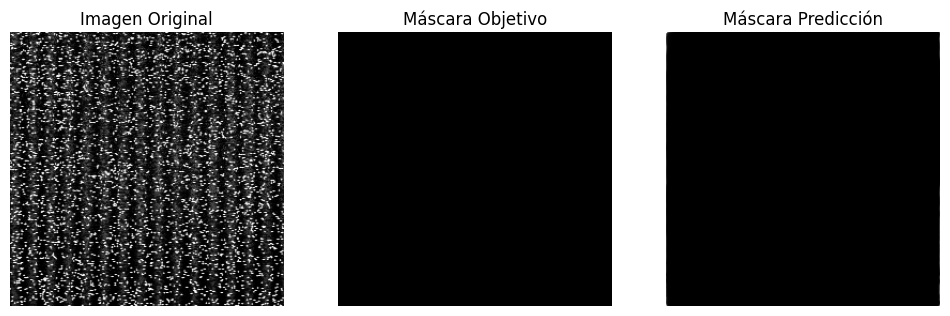

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 226ms/step - IoU: 0.4899 - accuracy: 0.9228 - loss: 0.0335 - val_IoU: 0.4636 - val_accuracy: 0.9775 - val_loss: 0.0701
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


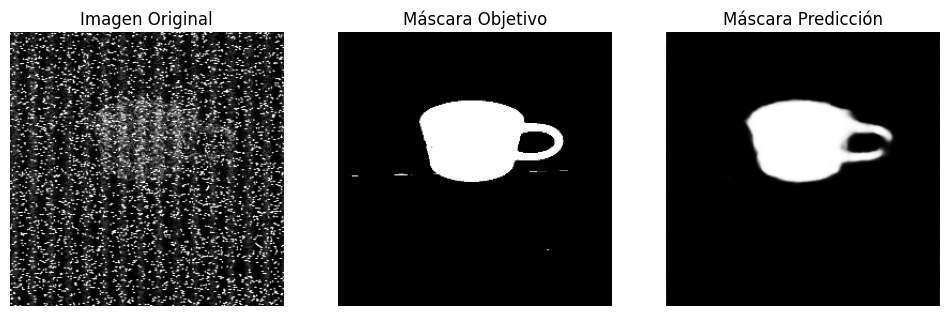

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 230ms/step - IoU: 0.4832 - accuracy: 0.9245 - loss: 0.0300 - val_IoU: 0.4645 - val_accuracy: 0.9751 - val_loss: 0.0858
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


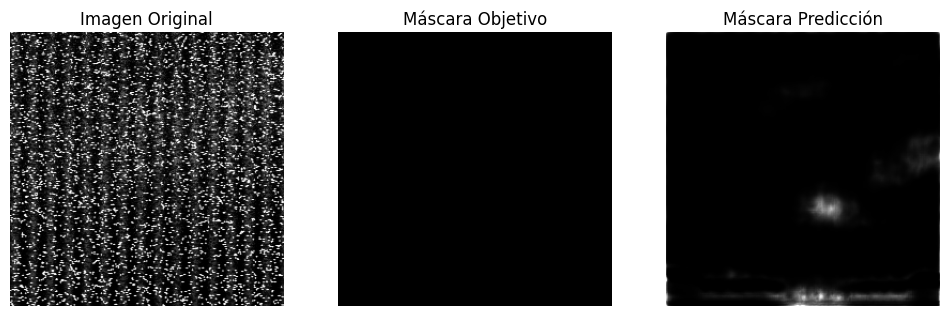

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.4799 - accuracy: 0.9208 - loss: 0.0429 - val_IoU: 0.4668 - val_accuracy: 0.9753 - val_loss: 0.0729
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


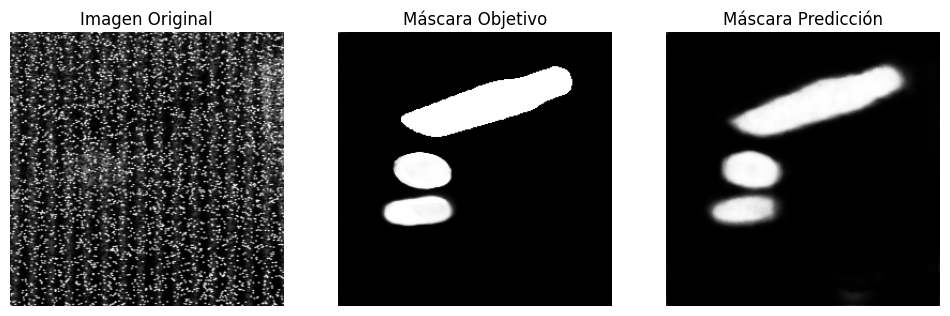

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.4862 - accuracy: 0.9229 - loss: 0.0426 - val_IoU: 0.4636 - val_accuracy: 0.9608 - val_loss: 0.1459
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


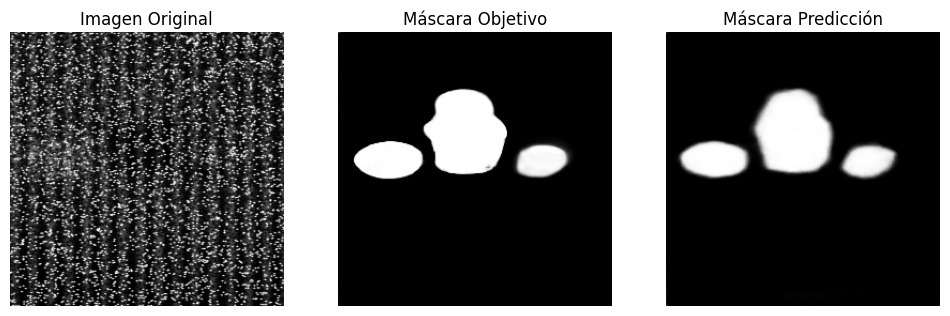

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.4950 - accuracy: 0.9182 - loss: 0.0444 - val_IoU: 0.4675 - val_accuracy: 0.9763 - val_loss: 0.0793
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


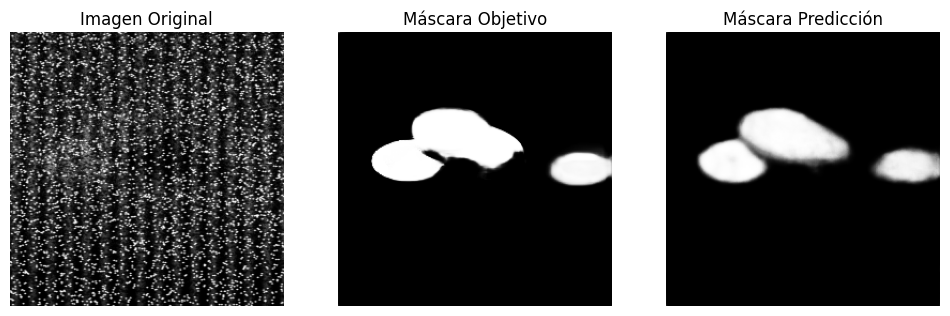

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.4857 - accuracy: 0.9261 - loss: 0.0328 - val_IoU: 0.4687 - val_accuracy: 0.9726 - val_loss: 0.0873
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


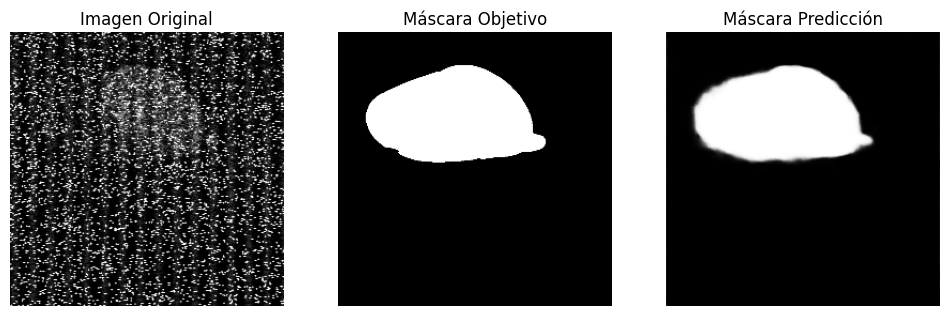

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 225ms/step - IoU: 0.4937 - accuracy: 0.9230 - loss: 0.0297 - val_IoU: 0.5044 - val_accuracy: 0.9742 - val_loss: 0.0848
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


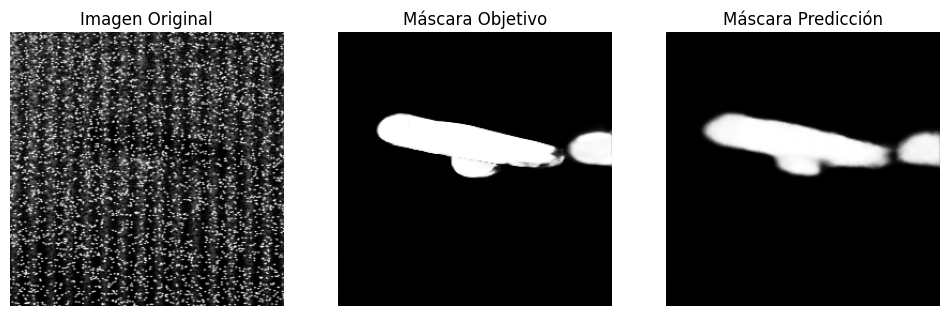

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 234ms/step - IoU: 0.5062 - accuracy: 0.9238 - loss: 0.0290 - val_IoU: 0.4705 - val_accuracy: 0.9715 - val_loss: 0.1063
Epoch 53/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


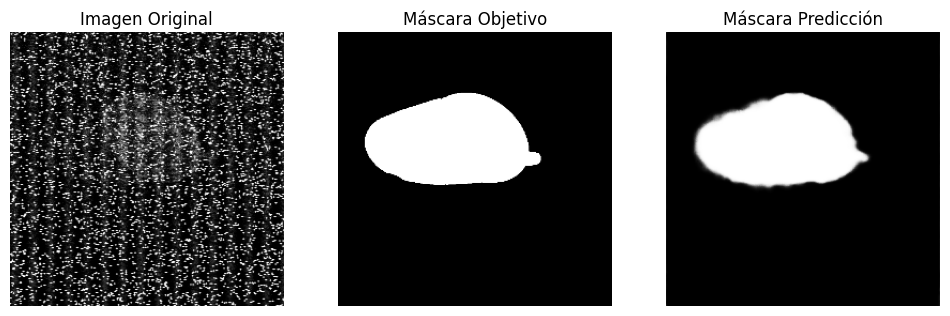

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 229ms/step - IoU: 0.5029 - accuracy: 0.9222 - loss: 0.0282 - val_IoU: 0.4799 - val_accuracy: 0.9773 - val_loss: 0.0877
Epoch 54/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


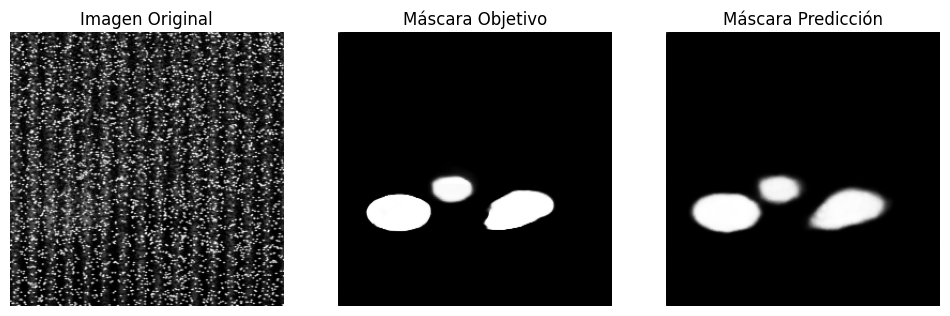

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 223ms/step - IoU: 0.5048 - accuracy: 0.9253 - loss: 0.0269 - val_IoU: 0.4797 - val_accuracy: 0.9754 - val_loss: 0.0842
Epoch 55/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


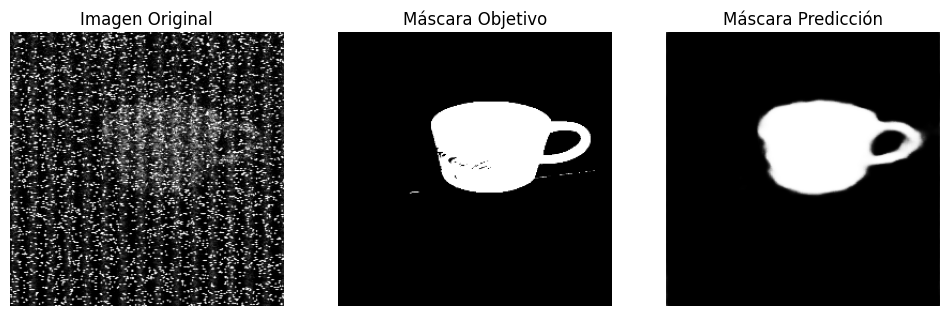

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 226ms/step - IoU: 0.5160 - accuracy: 0.9237 - loss: 0.0271 - val_IoU: 0.4836 - val_accuracy: 0.9735 - val_loss: 0.0928
Epoch 56/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


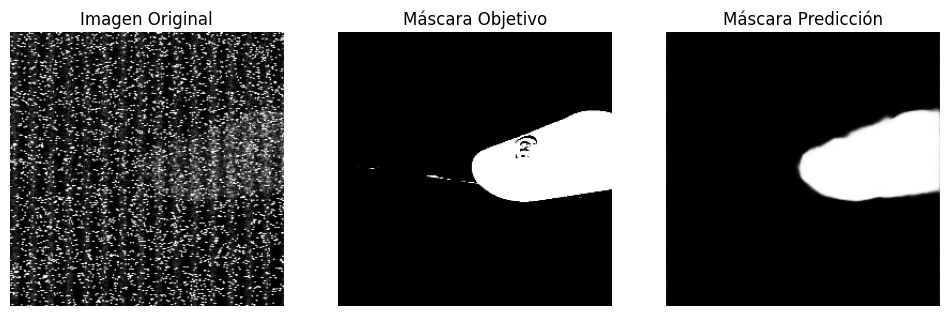

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 224ms/step - IoU: 0.5172 - accuracy: 0.9266 - loss: 0.0264 - val_IoU: 0.4920 - val_accuracy: 0.9724 - val_loss: 0.1046
Epoch 57/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


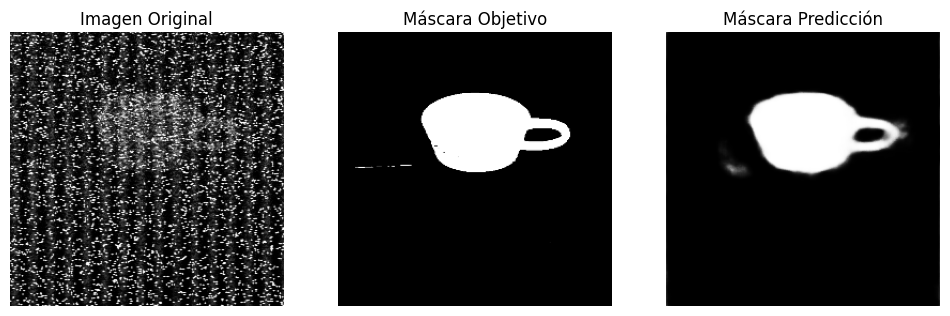

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.5128 - accuracy: 0.9259 - loss: 0.0258 - val_IoU: 0.4862 - val_accuracy: 0.9724 - val_loss: 0.0997
Epoch 58/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


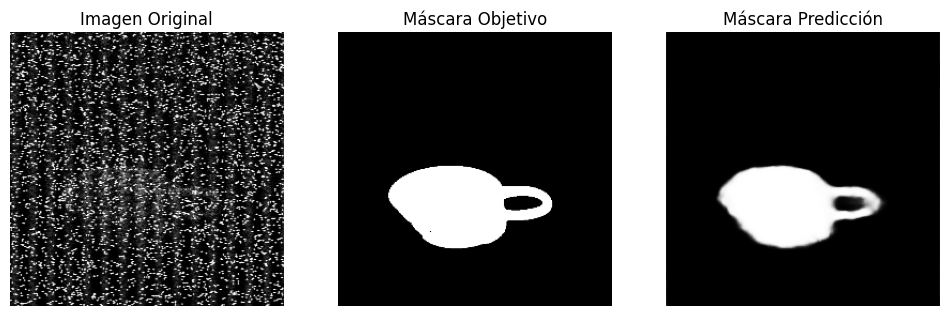

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 224ms/step - IoU: 0.5170 - accuracy: 0.9276 - loss: 0.0263 - val_IoU: 0.4862 - val_accuracy: 0.9754 - val_loss: 0.0921
Epoch 59/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


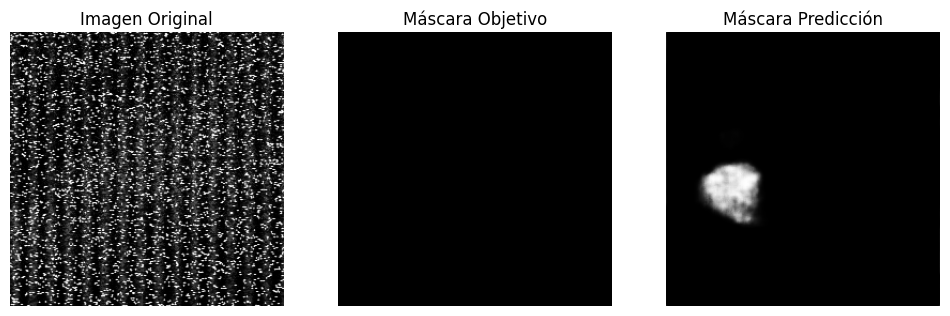

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 224ms/step - IoU: 0.5256 - accuracy: 0.9266 - loss: 0.0255 - val_IoU: 0.4917 - val_accuracy: 0.9755 - val_loss: 0.1003
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


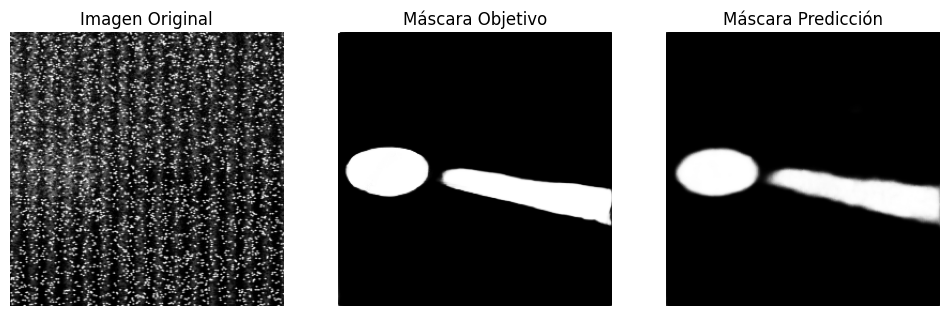

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 225ms/step - IoU: 0.5199 - accuracy: 0.9231 - loss: 0.0257 - val_IoU: 0.5036 - val_accuracy: 0.9748 - val_loss: 0.1022
Epoch 61/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


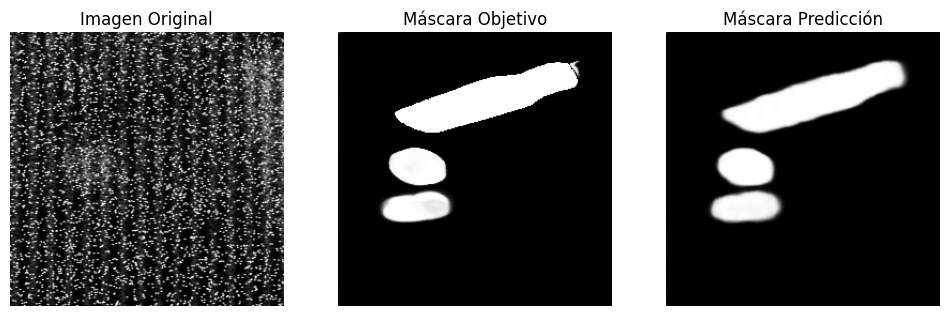

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 230ms/step - IoU: 0.5203 - accuracy: 0.9252 - loss: 0.0261 - val_IoU: 0.4904 - val_accuracy: 0.9745 - val_loss: 0.1007
Epoch 62/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


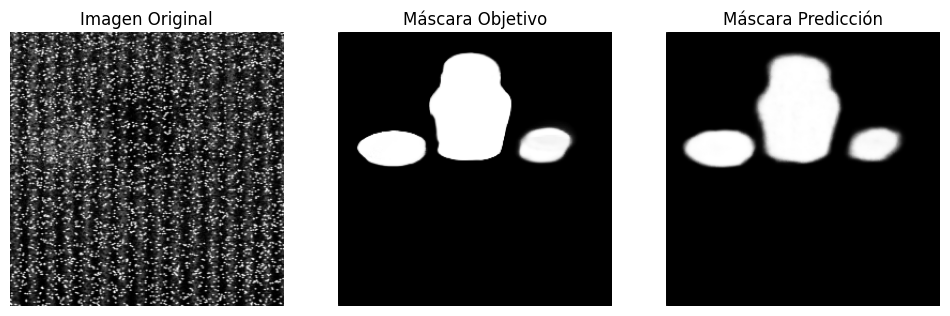

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.5197 - accuracy: 0.9259 - loss: 0.0249 - val_IoU: 0.4797 - val_accuracy: 0.9740 - val_loss: 0.0984
Epoch 63/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


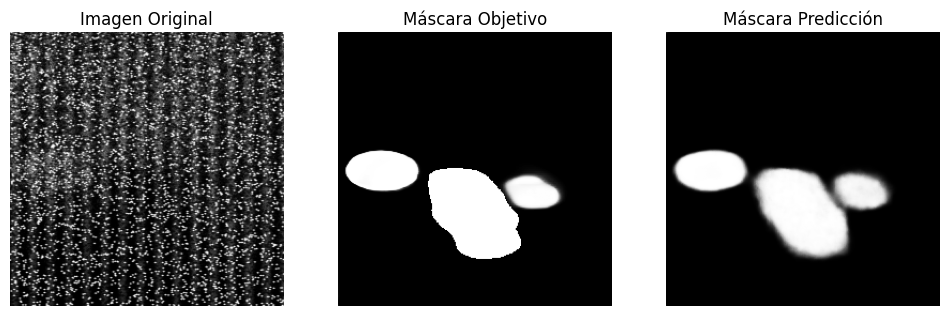

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.5158 - accuracy: 0.9208 - loss: 0.0245 - val_IoU: 0.4785 - val_accuracy: 0.9740 - val_loss: 0.0950
Epoch 64/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


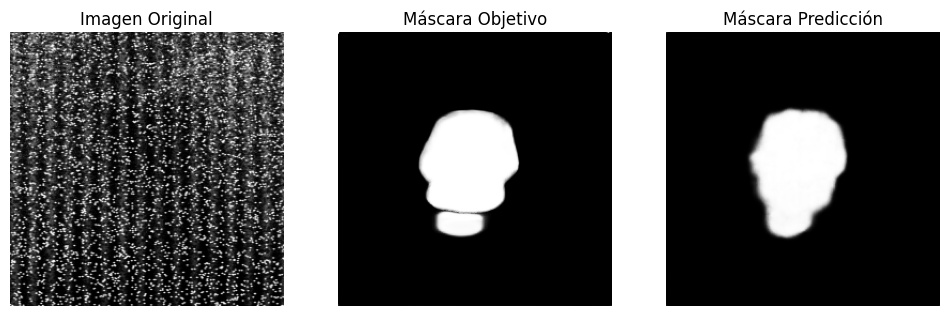

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.5143 - accuracy: 0.9231 - loss: 0.0255 - val_IoU: 0.4802 - val_accuracy: 0.9735 - val_loss: 0.1046
Epoch 65/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


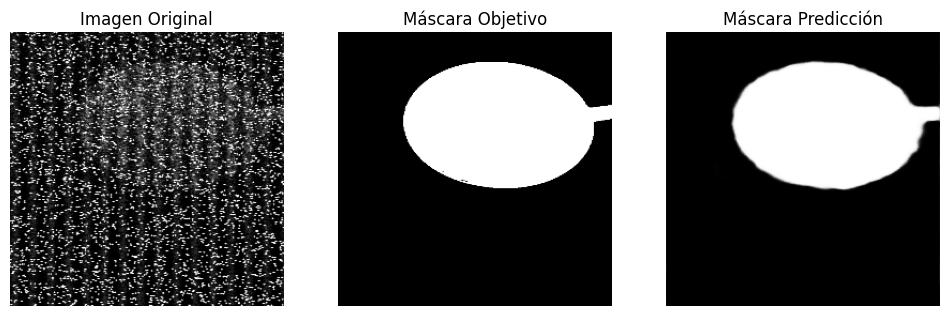

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 225ms/step - IoU: 0.5226 - accuracy: 0.9234 - loss: 0.0246 - val_IoU: 0.4831 - val_accuracy: 0.9725 - val_loss: 0.1134
Epoch 66/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


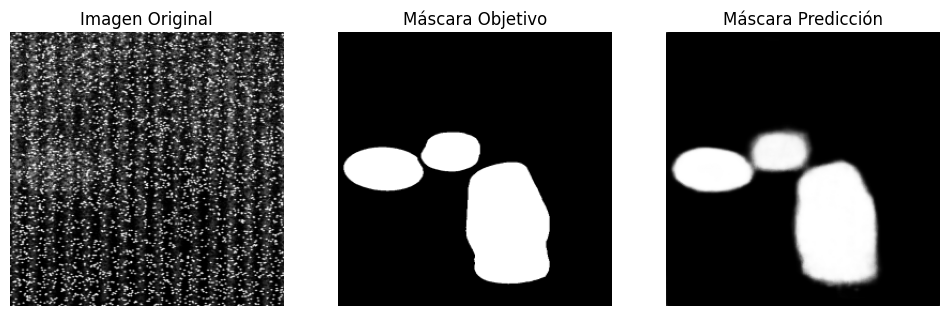

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 227ms/step - IoU: 0.5207 - accuracy: 0.9282 - loss: 0.0241 - val_IoU: 0.4808 - val_accuracy: 0.9716 - val_loss: 0.1174
Epoch 67/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


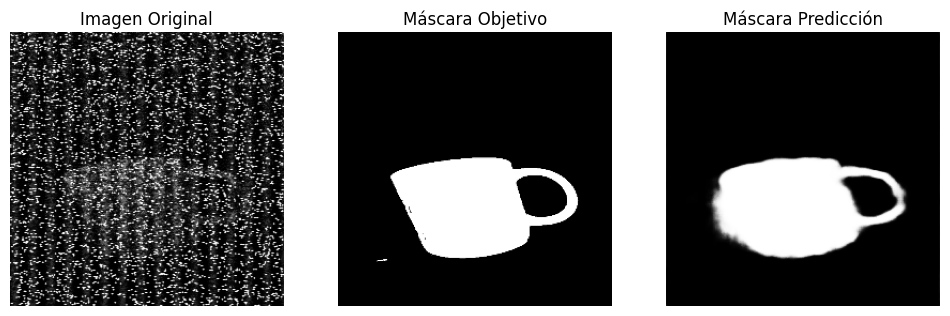

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 230ms/step - IoU: 0.5235 - accuracy: 0.9226 - loss: 0.0268 - val_IoU: 0.5007 - val_accuracy: 0.9718 - val_loss: 0.1312
Epoch 68/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


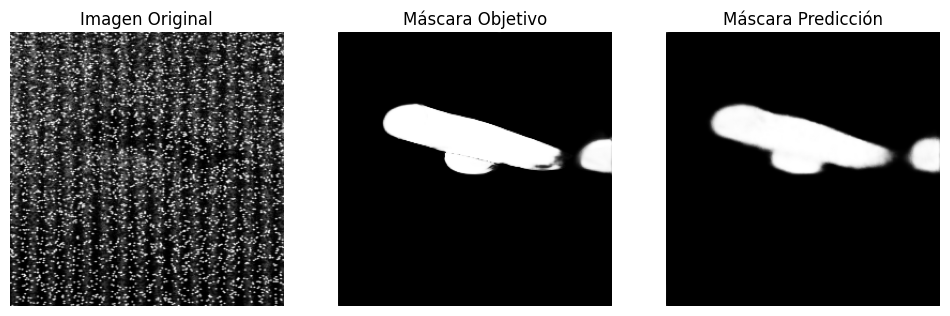

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.5480 - accuracy: 0.9257 - loss: 0.0239 - val_IoU: 0.4844 - val_accuracy: 0.9732 - val_loss: 0.1088
Epoch 69/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


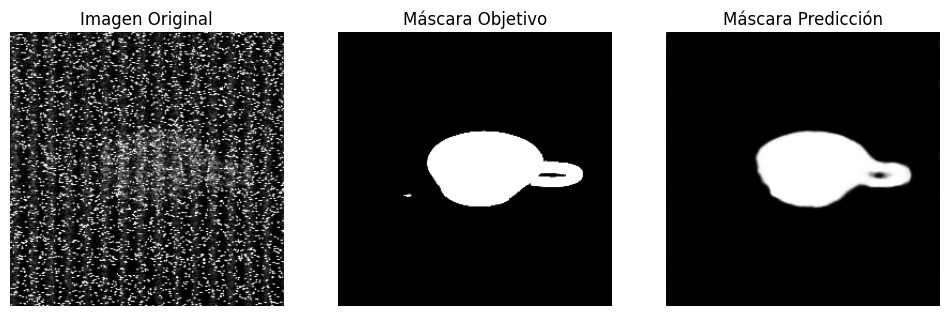

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 224ms/step - IoU: 0.5241 - accuracy: 0.9258 - loss: 0.0233 - val_IoU: 0.4880 - val_accuracy: 0.9750 - val_loss: 0.1014
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


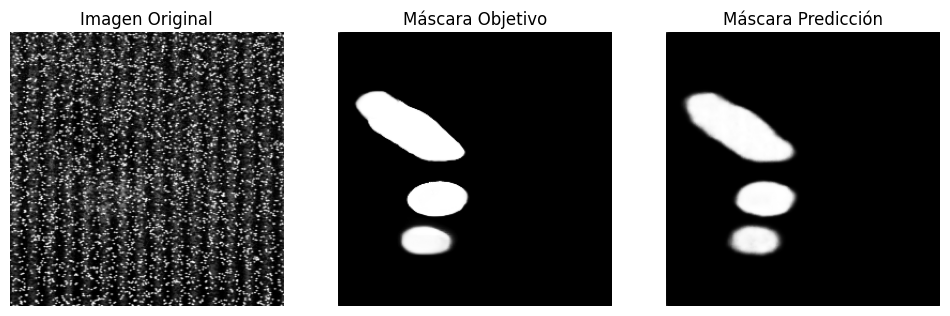

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.5338 - accuracy: 0.9233 - loss: 0.0230 - val_IoU: 0.4877 - val_accuracy: 0.9722 - val_loss: 0.1077
Epoch 71/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


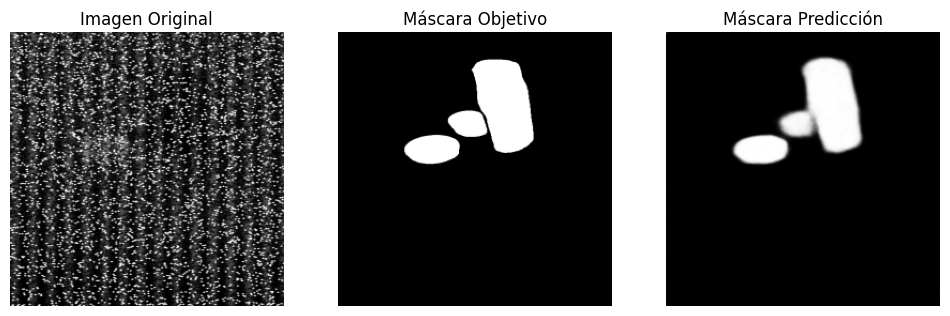

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 231ms/step - IoU: 0.5248 - accuracy: 0.9280 - loss: 0.0243 - val_IoU: 0.4825 - val_accuracy: 0.9746 - val_loss: 0.1083
Epoch 72/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


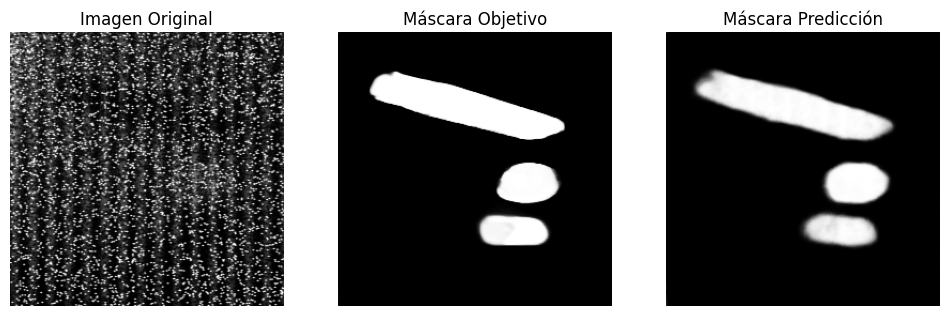

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 243ms/step - IoU: 0.5038 - accuracy: 0.9211 - loss: 0.0325 - val_IoU: 0.4637 - val_accuracy: 0.9812 - val_loss: 0.0607
Epoch 73/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


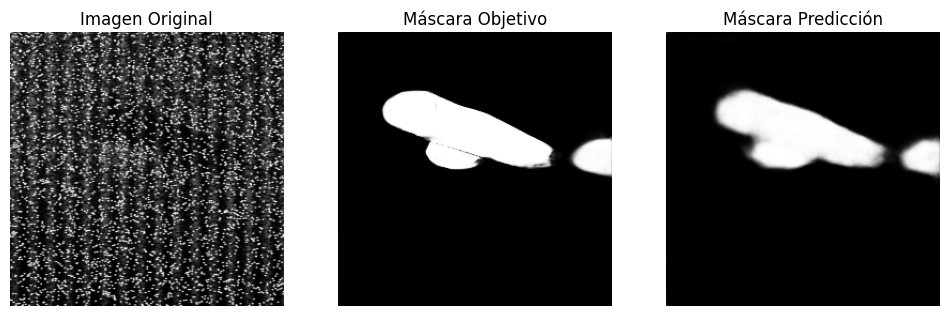

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 231ms/step - IoU: 0.5011 - accuracy: 0.9251 - loss: 0.0299 - val_IoU: 0.4636 - val_accuracy: 0.9787 - val_loss: 0.0892
Epoch 74/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


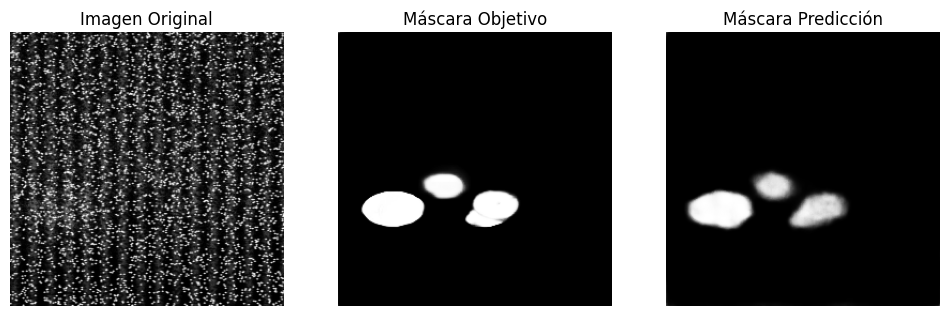

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 227ms/step - IoU: 0.4806 - accuracy: 0.9186 - loss: 0.0538 - val_IoU: 0.4636 - val_accuracy: 0.9751 - val_loss: 0.0678
Epoch 75/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


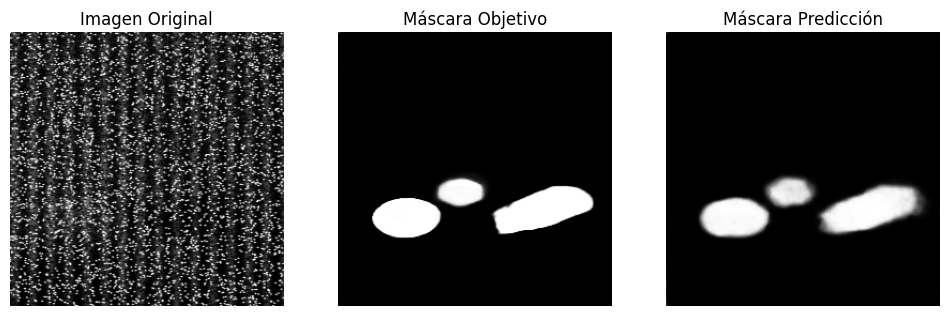

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 231ms/step - IoU: 0.4971 - accuracy: 0.9261 - loss: 0.0305 - val_IoU: 0.4645 - val_accuracy: 0.9707 - val_loss: 0.0869
Epoch 76/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


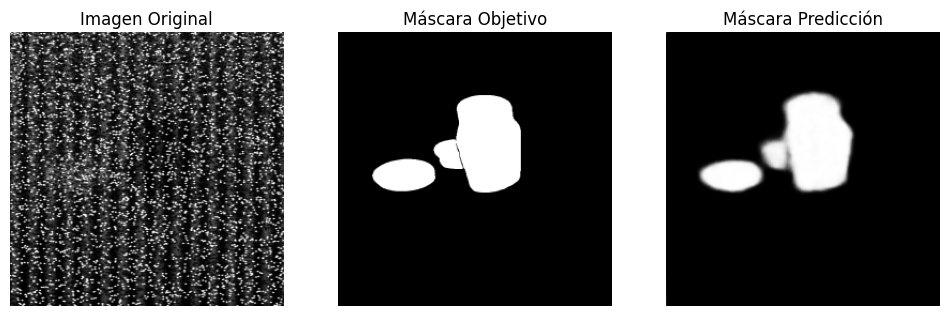

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.4867 - accuracy: 0.9247 - loss: 0.0278 - val_IoU: 0.4880 - val_accuracy: 0.9709 - val_loss: 0.0977
Epoch 77/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


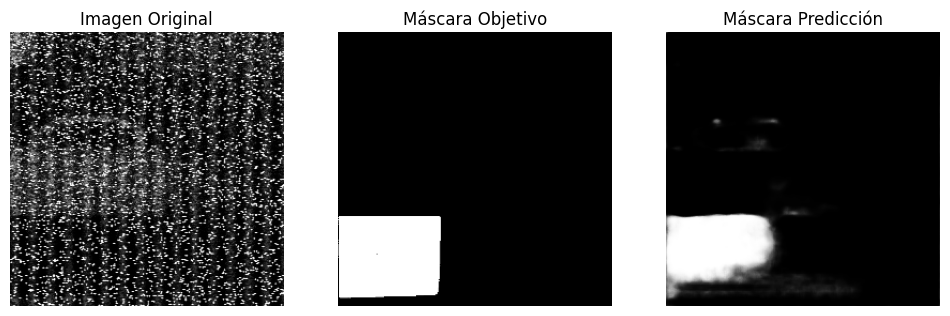

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 230ms/step - IoU: 0.5011 - accuracy: 0.9225 - loss: 0.0284 - val_IoU: 0.4786 - val_accuracy: 0.9737 - val_loss: 0.0901
Epoch 78/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


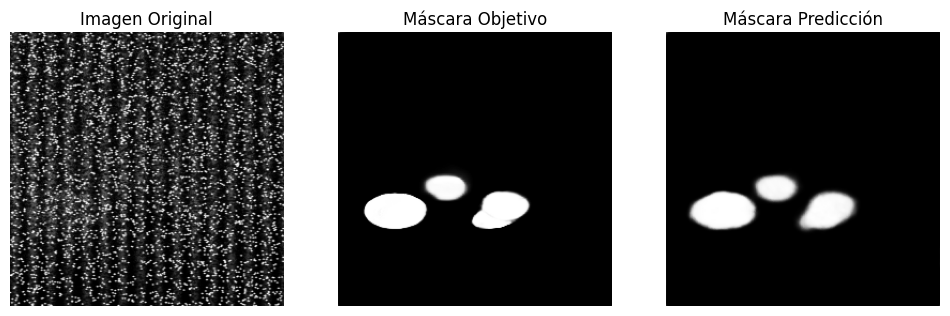

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.5039 - accuracy: 0.9288 - loss: 0.0237 - val_IoU: 0.4946 - val_accuracy: 0.9763 - val_loss: 0.0877
Epoch 79/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


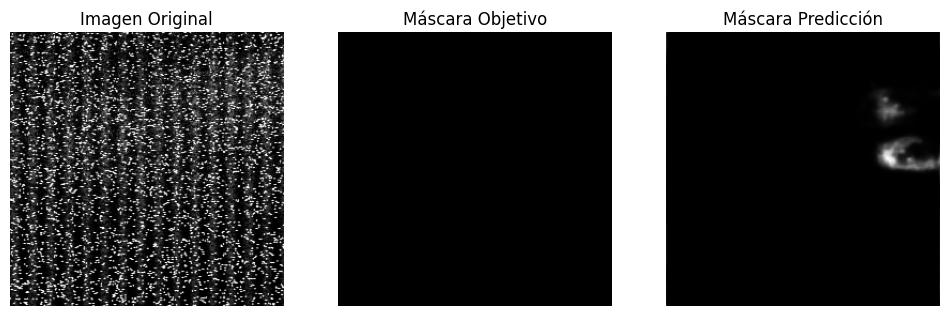

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.5094 - accuracy: 0.9242 - loss: 0.0230 - val_IoU: 0.4778 - val_accuracy: 0.9761 - val_loss: 0.0968
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


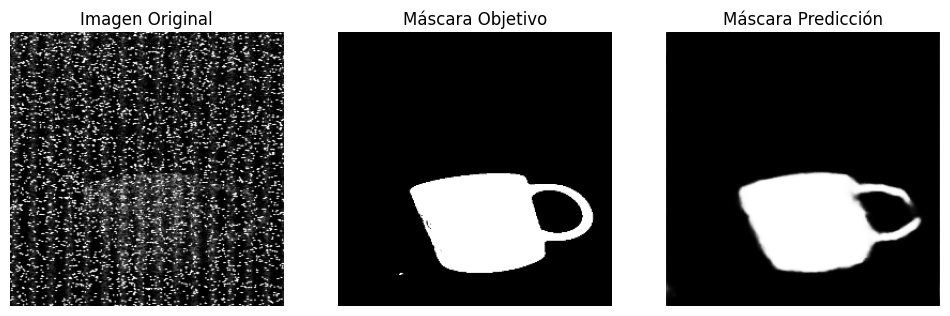

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.5132 - accuracy: 0.9271 - loss: 0.0229 - val_IoU: 0.4915 - val_accuracy: 0.9719 - val_loss: 0.1012
Epoch 81/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


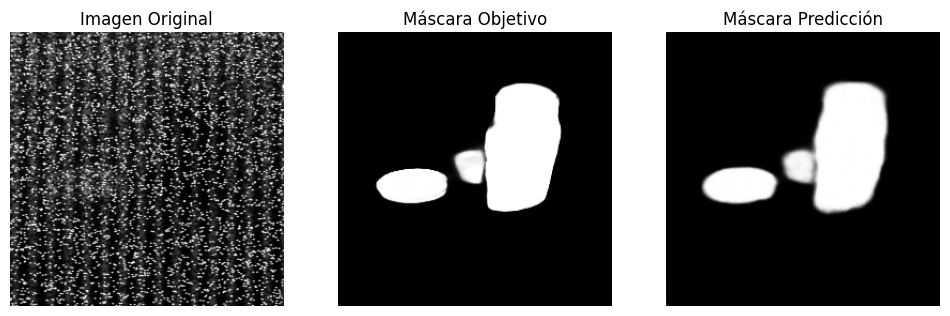

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 229ms/step - IoU: 0.5168 - accuracy: 0.9224 - loss: 0.0227 - val_IoU: 0.4862 - val_accuracy: 0.9745 - val_loss: 0.0944
Epoch 82/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


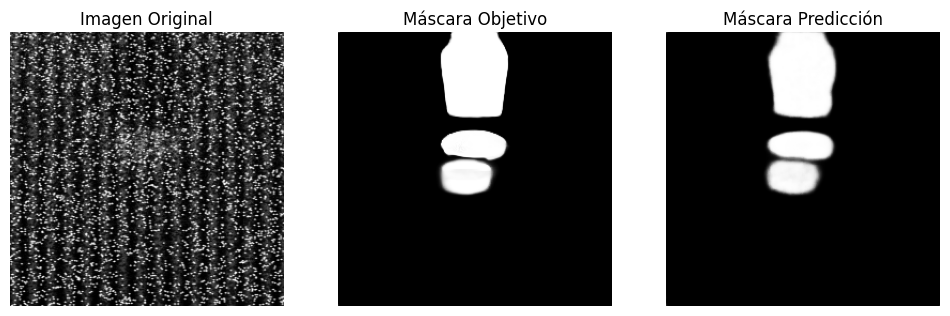

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 224ms/step - IoU: 0.5087 - accuracy: 0.9240 - loss: 0.0226 - val_IoU: 0.5037 - val_accuracy: 0.9738 - val_loss: 0.1050
Epoch 83/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


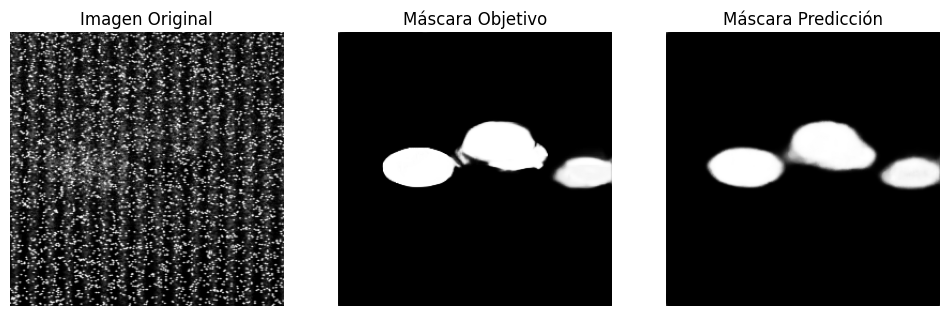

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 225ms/step - IoU: 0.5253 - accuracy: 0.9269 - loss: 0.0219 - val_IoU: 0.4840 - val_accuracy: 0.9767 - val_loss: 0.0896
Epoch 84/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


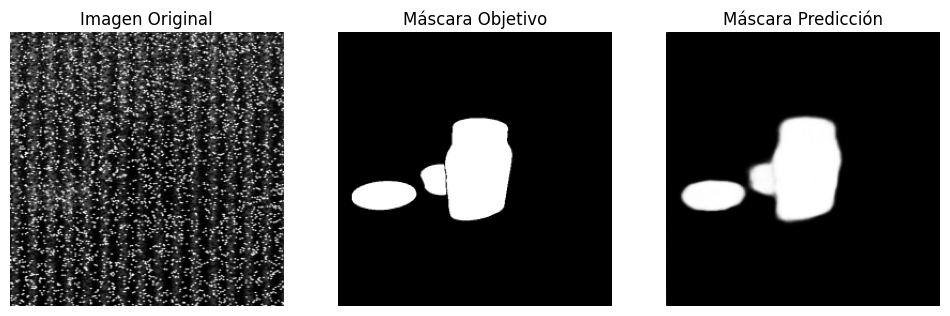

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 236ms/step - IoU: 0.5282 - accuracy: 0.9231 - loss: 0.0216 - val_IoU: 0.5077 - val_accuracy: 0.9711 - val_loss: 0.1228
Epoch 85/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


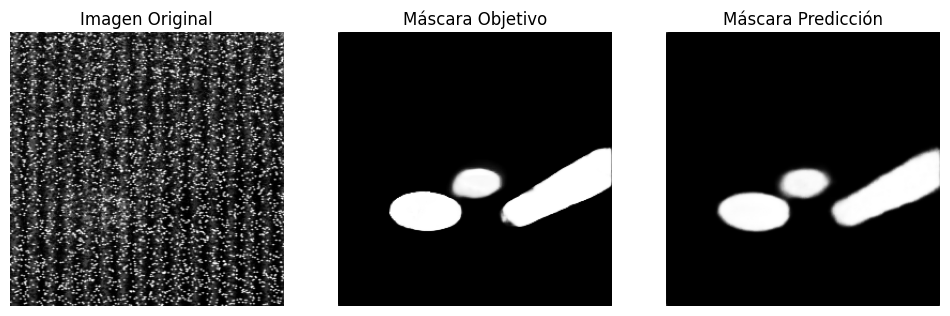

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 230ms/step - IoU: 0.5282 - accuracy: 0.9264 - loss: 0.0223 - val_IoU: 0.4765 - val_accuracy: 0.9758 - val_loss: 0.0916
Epoch 86/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


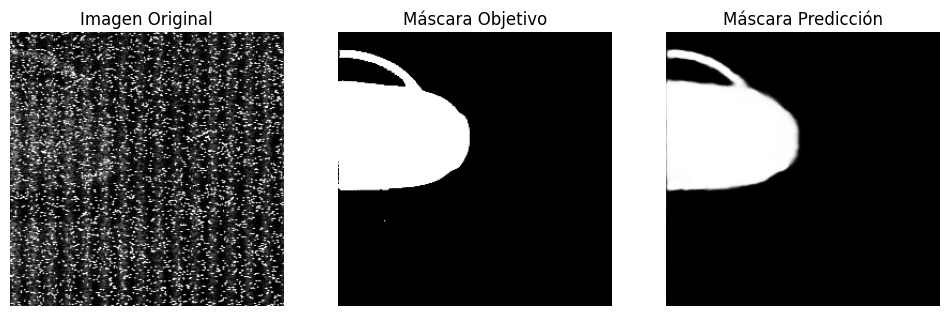

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 226ms/step - IoU: 0.5079 - accuracy: 0.9270 - loss: 0.0221 - val_IoU: 0.4993 - val_accuracy: 0.9713 - val_loss: 0.1185
Epoch 87/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step


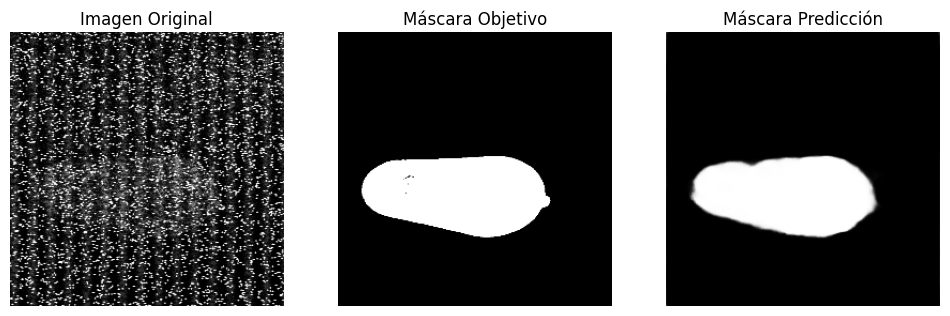

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 231ms/step - IoU: 0.5319 - accuracy: 0.9273 - loss: 0.0210 - val_IoU: 0.4920 - val_accuracy: 0.9748 - val_loss: 0.0948
Epoch 88/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


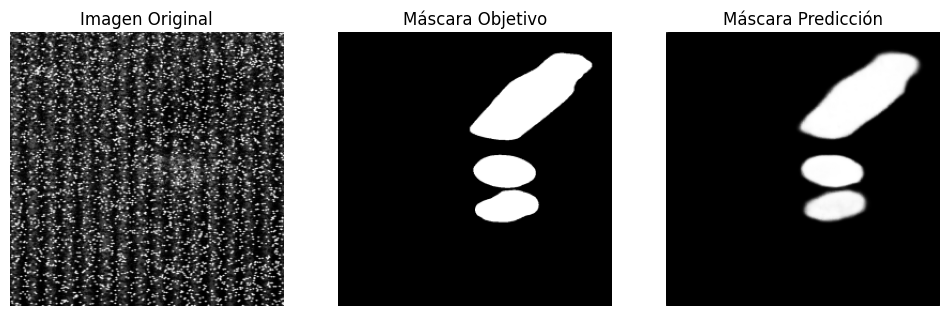

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.5291 - accuracy: 0.9243 - loss: 0.0209 - val_IoU: 0.4979 - val_accuracy: 0.9752 - val_loss: 0.1071
Epoch 89/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


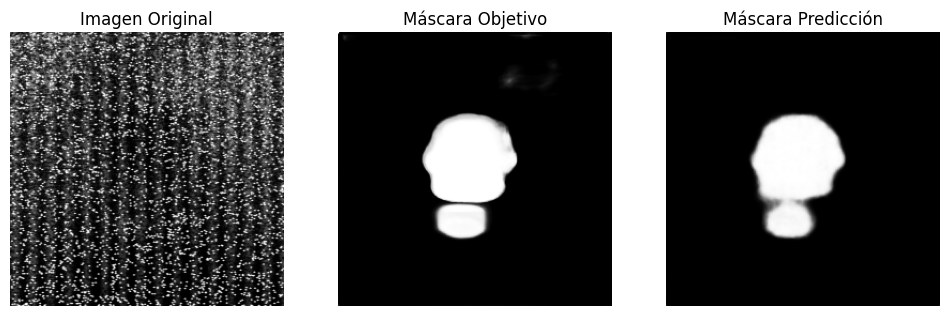

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 233ms/step - IoU: 0.5225 - accuracy: 0.9226 - loss: 0.0209 - val_IoU: 0.4790 - val_accuracy: 0.9744 - val_loss: 0.1059
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


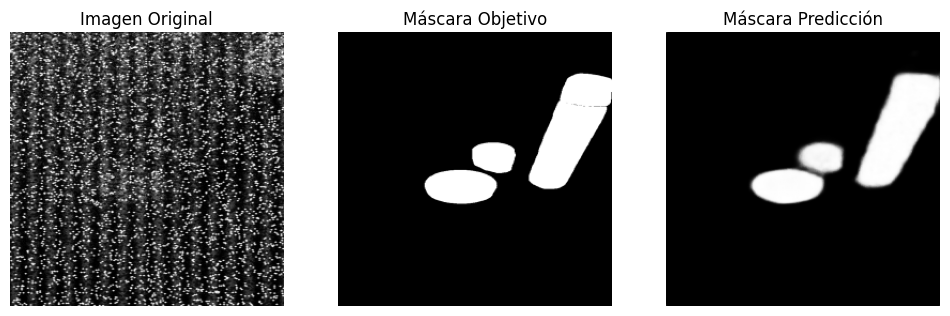

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 227ms/step - IoU: 0.5256 - accuracy: 0.9250 - loss: 0.0206 - val_IoU: 0.4796 - val_accuracy: 0.9748 - val_loss: 0.1013
Epoch 91/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


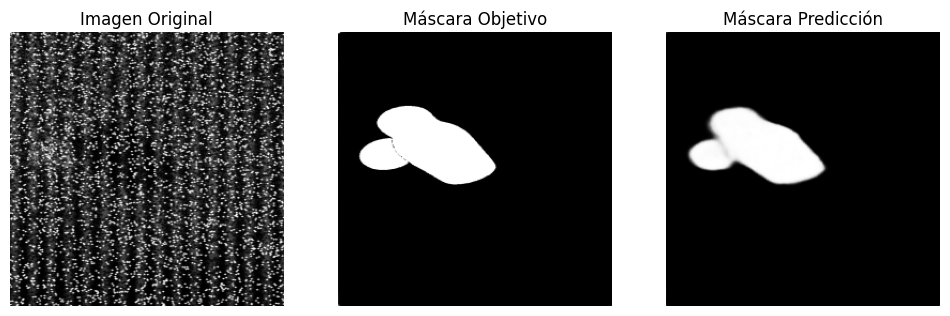

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 232ms/step - IoU: 0.5176 - accuracy: 0.9278 - loss: 0.0205 - val_IoU: 0.5037 - val_accuracy: 0.9720 - val_loss: 0.1140
Epoch 92/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


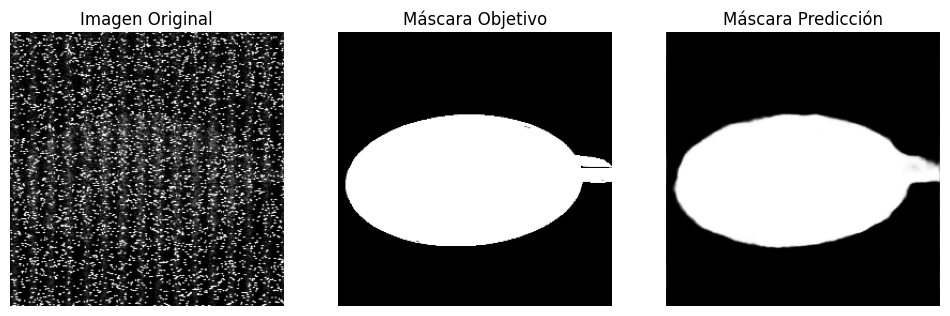

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 227ms/step - IoU: 0.5363 - accuracy: 0.9248 - loss: 0.0209 - val_IoU: 0.5020 - val_accuracy: 0.9739 - val_loss: 0.1138
Epoch 93/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


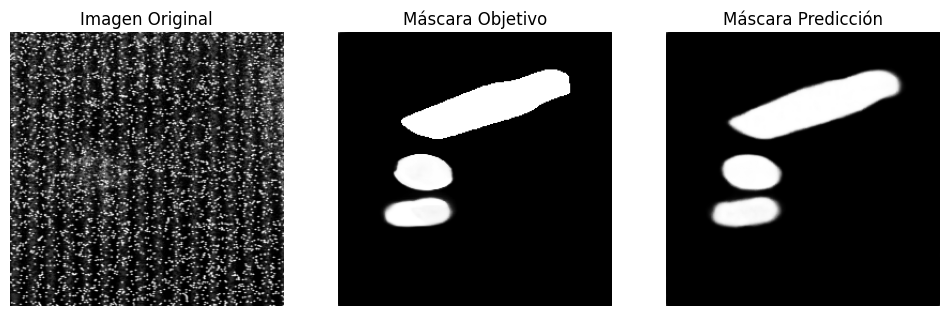

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 230ms/step - IoU: 0.5302 - accuracy: 0.9242 - loss: 0.0206 - val_IoU: 0.4909 - val_accuracy: 0.9771 - val_loss: 0.0939
Epoch 94/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


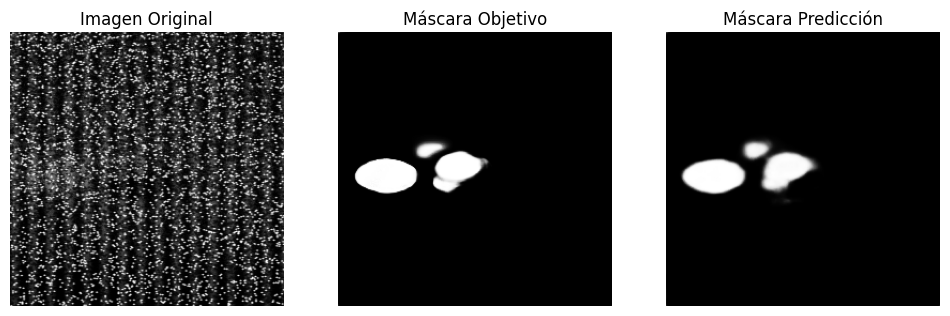

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 229ms/step - IoU: 0.5294 - accuracy: 0.9259 - loss: 0.0206 - val_IoU: 0.5196 - val_accuracy: 0.9724 - val_loss: 0.1226
Epoch 95/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


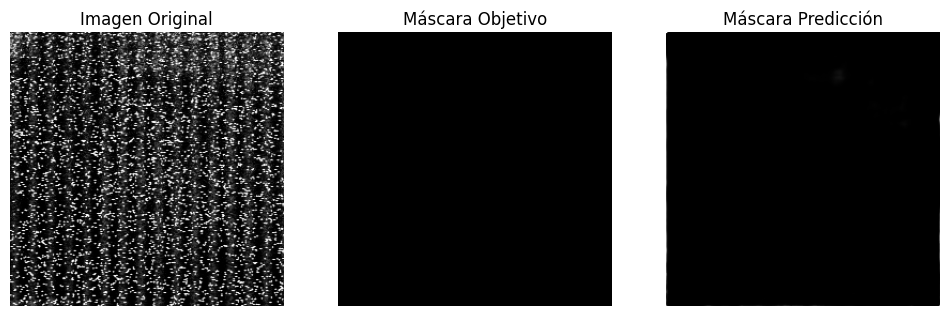

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.5351 - accuracy: 0.9301 - loss: 0.0202 - val_IoU: 0.4926 - val_accuracy: 0.9750 - val_loss: 0.1016
Epoch 96/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


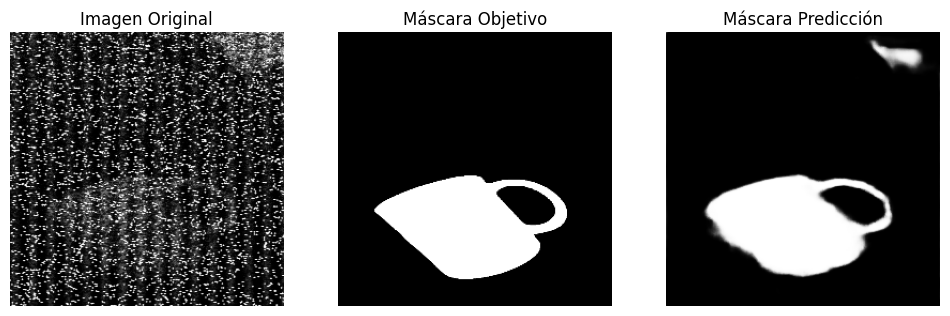

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 230ms/step - IoU: 0.5426 - accuracy: 0.9286 - loss: 0.0206 - val_IoU: 0.4992 - val_accuracy: 0.9783 - val_loss: 0.0811
Epoch 97/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


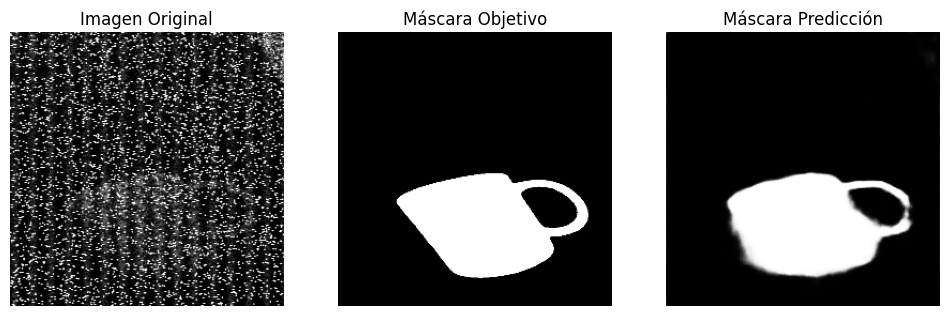

74/74 ━━━━━━━━━━━━━━━━━━━━ 20s 226ms/step - IoU: 0.5482 - accuracy: 0.9281 - loss: 0.0260 - val_IoU: 0.4977 - val_accuracy: 0.9742 - val_loss: 0.1041
Epoch 98/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


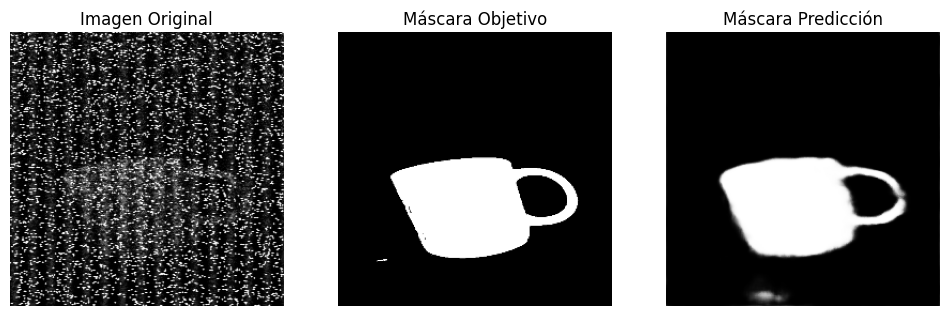

74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 228ms/step - IoU: 0.5223 - accuracy: 0.9255 - loss: 0.0230 - val_IoU: 0.4805 - val_accuracy: 0.9762 - val_loss: 0.0886
Epoch 99/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


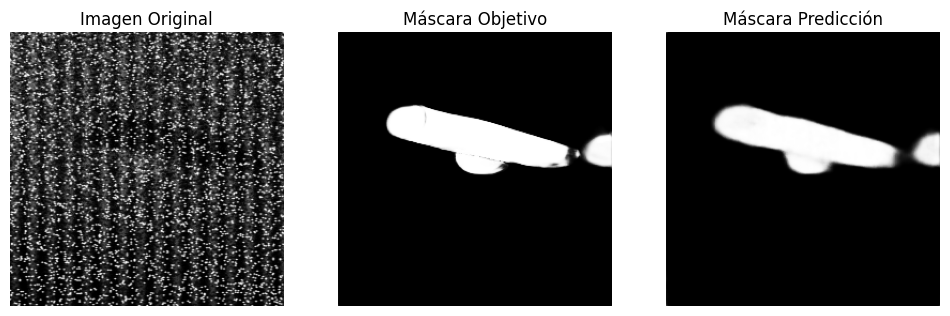

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 231ms/step - IoU: 0.5122 - accuracy: 0.9235 - loss: 0.0234 - val_IoU: 0.4712 - val_accuracy: 0.9786 - val_loss: 0.0942
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


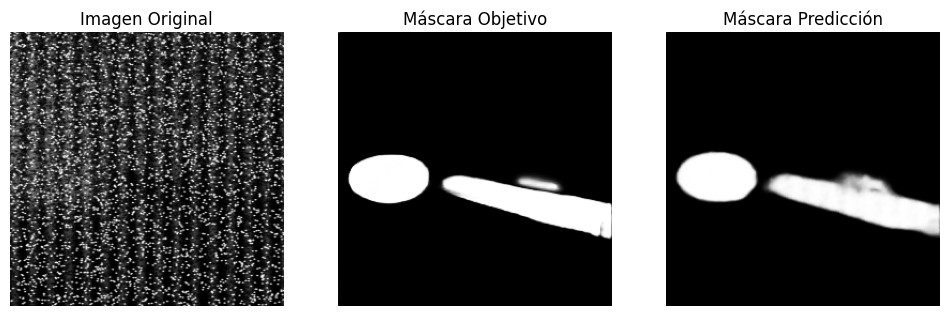

74/74 ━━━━━━━━━━━━━━━━━━━━ 17s 228ms/step - IoU: 0.5150 - accuracy: 0.9243 - loss: 0.0224 - val_IoU: 0.4950 - val_accuracy: 0.9772 - val_loss: 0.1520


In [31]:
# Configuración de entrenamiento
BATCH_SIZE = 8

# Entrenamiento
results = model.fit(
    [images, angles],  # Pasar imágenes y ángulos como lista
    masks,             # Las máscaras son la única salida
    validation_split=0.2,
    epochs=100,
    batch_size=BATCH_SIZE,
    callbacks=cb
)

# **Evaluation**

In [32]:
loss, accuracy, iou, val_loss, val_accuracy, val_iou = results.history.values()

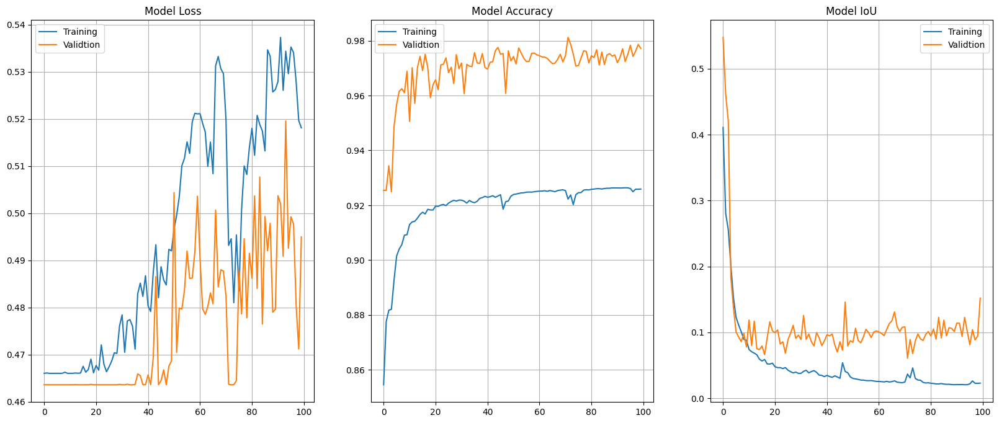

In [33]:
plt.figure(figsize=(20,8))

plt.subplot(1,3,1)
plt.title("Model Loss")
plt.plot(loss, label="Training")
plt.plot(val_loss, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,2)
plt.title("Model Accuracy")
plt.plot(accuracy, label="Training")
plt.plot(val_accuracy, label="Validtion")
plt.legend()
plt.grid()

plt.subplot(1,3,3)
plt.title("Model IoU")
plt.plot(iou, label="Training")
plt.plot(val_iou, label="Validtion")
plt.legend()
plt.grid()

plt.show()

In [34]:
plt.figure(figsize=(20,25))
n=0
for i in range(1,(5*3)+1):
    plt.subplot(5,3,i)
    if n==0:
        id = np.random.randint(len(images))
        image = images[id]
        mask = masks[id]
        angle = angles[id]
        pred_mask = model.predict([image[np.newaxis, ...], angle[np.newaxis, ...]])


        plt.title("Original Mask")
        show_mask(image, mask)
        n+=1
    elif n==1:
        plt.title("Predicted Mask")
        show_mask(image, pred_mask)
        n+=1
    elif n==2:
        pred_mask = (pred_mask>0.5).astype('float')
        plt.title("Processed Mask")
        show_mask(image, pred_mask)
        n=0
plt.tight_layout()
plt.show()

Output hidden; open in https://colab.research.google.com to view.

In [35]:
# Guardar resultados en CSV
pd.DataFrame(results.history).to_csv('/content/drive/Othercomputers/Mi PC/Master IA/Practicas Empresa/Imagen/taza_dataset_angle/modelo-tr/training_history_angulo_decode_capa_final.csv', index=False)


In [36]:
search_text = 'figura2_frame_96'

i = 0
for class_path in single_mask_paths:
    for path in class_path:
        i = i + 1
        if search_text in path :
          print(i)
          break


655


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


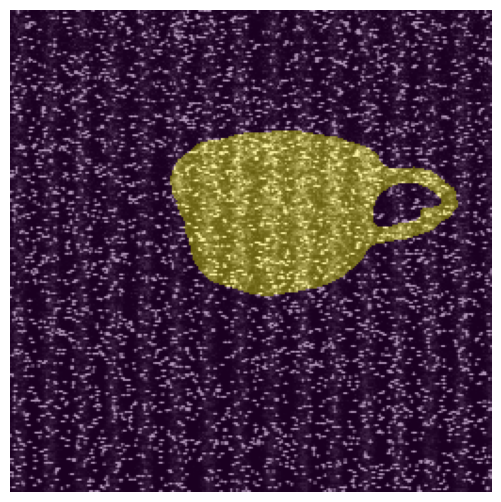

In [37]:
plt.figure(figsize=(20,25))
n=0
id = 655
plt.subplot(5,3,1)
image = images[id]
mask = masks[id]
angle = angles[id]
pred_mask = model.predict([image[np.newaxis, ...], angle[np.newaxis, ...]])

pred_mask = (pred_mask>0.5).astype('float')

show_mask(image, pred_mask)
n=0
plt.tight_layout()
plt.show()